In [1]:
import pandas as pd
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 200)
import matplotlib.pyplot as plt

import pickle

In [2]:
import utils

In [3]:
import pandas as pd
import re

extruder = 'EX1'

ex_data = pd.read_csv(f"data/{extruder}_processed.csv")
ex_data['Unnamed: 0'] = pd.to_datetime(ex_data['Unnamed: 0'])
ex_data = ex_data.set_index('Unnamed: 0').rename_axis('Date and Time')
#ex_data.index = pd.to_datetime(ex_data.index)
ex_data.dropna(inplace=True)

In [4]:
ex_data.head()

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),sample_gap_minutes,48H_max_gap_backward,1H_max_gap_forward,well_sampled,HAZARD_CONDITION,hours_to_hazard,hazard_within_24h
Date and Time,,,,,,,,,,,,,,,
2023-07-17 16:06:00,0.000000,0.000000,6.952558e-310,0.000000,0.000000,0.00,0.0,6.952558e-310,0.333333,0.333333,1.316667,True,False,193.991667,False
2023-07-17 16:06:30,0.000000,0.000000,6.952558e-310,0.000000,0.000000,0.00,0.0,6.952558e-310,0.333333,0.333333,1.316667,True,False,193.983333,False
2023-07-17 16:07:00,0.000000,0.000000,6.952558e-310,0.000000,0.000000,0.00,0.0,6.952558e-310,0.333333,0.333333,1.316667,True,False,193.975000,False
2023-07-17 16:07:30,4536.830078,27.810188,3.500000e+01,350.257812,50.927612,5.52,1.0,7.000000e+01,1.316667,1.316667,1.316667,True,False,193.966667,False
2023-07-17 16:08:00,4607.748047,27.810188,3.500000e+01,350.257812,50.936874,5.52,1.0,7.000000e+01,0.033333,1.316667,0.066667,True,False,193.958333,False


In [5]:
ex_data.tail()

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),sample_gap_minutes,48H_max_gap_backward,1H_max_gap_forward,well_sampled,HAZARD_CONDITION,hours_to_hazard,hazard_within_24h
Date and Time,,,,,,,,,,,,,,,
2024-01-14 04:48:30,5889.154297,21.694565,25.0,335.365234,75.856140,5.65,2.27,65.0,0.033333,1.666667,0.033333,True,True,0.0,True
2024-01-14 04:49:00,5922.802734,21.694565,25.0,335.365234,75.899078,5.62,2.29,65.0,0.033333,1.666667,0.033333,True,True,0.0,True
2024-01-14 04:49:30,5874.656250,21.694565,25.0,335.365234,75.885193,5.61,2.34,65.0,0.033333,1.666667,0.033333,True,True,0.0,True
2024-01-14 04:50:00,5937.527344,21.694565,25.0,335.365234,76.029800,5.61,2.34,65.0,0.033333,1.666667,0.033333,True,True,0.0,True
2024-01-14 04:50:30,5891.390625,21.694565,25.0,335.365234,75.855225,5.63,2.30,65.0,0.033333,1.666667,0.033333,True,True,0.0,True


In [6]:
min_time = ex_data.index.min()
well_sampled_cutoff = min_time + pd.Timedelta(hours=48)
min_time, well_sampled_cutoff

ex_data.loc[ex_data.index < well_sampled_cutoff,'well_sampled'] = False

In [7]:
# Extruder Pressure - for rolling
# for lagged variables - Extruder Die Temp, Extruder Thrust

#test = ex1_data.iloc[:1000][['Extruder Pressure']]

for time_window in ['5T', '15T', '30T', '1H', '3H', '6H', '12H', '24H', '48H']:
    if 'T' in time_window:
        label_append = time_window.replace('T', 'min')
    elif 'H' in time_window:
        label_append = time_window.replace('H', 'hour')

    col_label = 'pressure-' + label_append + '_avg'
    ex_data[col_label] = ex_data['Extruder Pressure'].rolling(time_window).mean()

    col_label = 'pressure-' + label_append + '_var'
    ex_data[col_label] = ex_data['Extruder Pressure'].rolling(time_window).var()

In [8]:
variables_to_lag = ['Extruder Die Temp', 'Extruder Thrust ',
                    'Screw Speed Output']

colname_map = {
    'Extruder Die Temp' : 'die_temp-',
    'Extruder Thrust ' : 'thrust-',
    'Screw Speed Output' : 'screw_speed_output-',
}

for time_window in ['15T', '1H', '3H', '6H']:
    if 'T' in time_window:
        label_append = time_window.replace('T', 'min')
    elif 'H' in time_window:
        label_append = time_window.replace('H', 'hour')
    for lagvar in variables_to_lag:
        col_label = colname_map[lagvar] + label_append + '_avg'
        ex_data[col_label] = \
            ex_data[lagvar].rolling(time_window).mean()
 #           tmp_df[new_col_name] = tmp_df[lagvar]
 #           tmp_df.drop(columns=lagvar, inplace=True)
 #       extruder_data = extruder_data.merge(
 #           tmp_df, 
 #           left_index=True, right_index=True,
 #           how='left'
 #       )
    #print(extruder_data.isnull().sum())
    #print(extruder_data[['hours_to_next_pause']].tail(20))
 #   ex_num += 1
#extruder_data.head(100)

In [9]:
ex_data.head()

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),sample_gap_minutes,48H_max_gap_backward,1H_max_gap_forward,well_sampled,HAZARD_CONDITION,hours_to_hazard,hazard_within_24h,pressure-5min_avg,pressure-5min_var,pressure-15min_avg,pressure-15min_var,pressure-30min_avg,pressure-30min_var,pressure-1hour_avg,pressure-1hour_var,pressure-3hour_avg,pressure-3hour_var,pressure-6hour_avg,pressure-6hour_var,pressure-12hour_avg,pressure-12hour_var,pressure-24hour_avg,pressure-24hour_var,pressure-48hour_avg,pressure-48hour_var,die_temp-15min_avg,thrust-15min_avg,screw_speed_output-15min_avg,die_temp-1hour_avg,thrust-1hour_avg,screw_speed_output-1hour_avg,die_temp-3hour_avg,thrust-3hour_avg,screw_speed_output-3hour_avg,die_temp-6hour_avg,thrust-6hour_avg,screw_speed_output-6hour_avg
Date and Time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2023-07-17 16:06:00,0.000000,0.000000,6.952558e-310,0.000000,0.000000,0.00,0.0,6.952558e-310,0.333333,0.333333,1.316667,False,False,193.991667,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2023-07-17 16:06:30,0.000000,0.000000,6.952558e-310,0.000000,0.000000,0.00,0.0,6.952558e-310,0.333333,0.333333,1.316667,False,False,193.983333,False,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2023-07-17 16:07:00,0.000000,0.000000,6.952558e-310,0.000000,0.000000,0.00,0.0,6.952558e-310,0.333333,0.333333,1.316667,False,False,193.975000,False,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2023-07-17 16:07:30,4536.830078,27.810188,3.500000e+01,350.257812,50.927612,5.52,1.0,7.000000e+01,1.316667,1.316667,1.316667,False,False,193.966667,False,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,1134.207520,5.145707e+06,87.564453,12.731903,6.952547,87.564453,12.731903,6.952547,87.564453,12.731903,6.952547,87.564453,12.731903,6.952547
2023-07-17 16:08:00,4607.748047,27.810188,3.500000e+01,350.257812,50.936874,5.52,1.0,7.000000e+01,0.033333,1.316667,0.066667,False,False,193.958333,False,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,1828.915625,6.272377e+06,140.103125,20.372897,11.124075,140.103125,20.372897,11.124075,140.103125,20.372897,11.124075,140.103125,20.372897,11.124075


In [10]:
# set up classifier variables -
# whether there is a pause within 
# {1 minute, 5 minutes, 10 minutes, 15 minutes, 30 minutes,
#  1 hour, 2 hours, 3 hours, 6 hours, 12 hours, 24 hours}

stop_target_to_hours_map = {
#    '1min' : 1/60,
    '5min' : 5/60,
    '10min': 10/60,
    '15min': 15/60,
    '30min': 30/60,
    '1hour': 1,
    '2hour': 2,
    '3hour': 3,
    '6hour':6,
    '12hour':12,
    '24hour':24,
}

for window in stop_target_to_hours_map:
    ex_data[f'{window}_hazard'] = \
        ex_data['hours_to_hazard'] < stop_target_to_hours_map[window]

In [11]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

def balance_dataset(X, y, over_sample_ratio=0.1, under_sample_ratio=0.5, mode='custom'):
    """
    Balances the dataset by over-sampling the minority class and under-sampling the majority class.

    :param X: Feature set.
    :param y: Labels.
    :param over_sample_ratio: Ratio of the number of samples in the minority class after resampling
                              to the number of samples in the majority class before resampling.
    :param under_sample_ratio: Ratio of the number of samples in the majority class after resampling
                               to the number of samples in the minority class after over-sampling.

    :return: Balanced features and labels.
    """
    
    # Define the resampling strategy
    if mode == 'auto':
        over = SMOTE(sampling_strategy='auto')
        under = RandomUnderSampler(sampling_strategy='auto')
    else:
        over = SMOTE(sampling_strategy=0.1)
        under = RandomUnderSampler(sampling_strategy=0.5)

    steps = [('o', over), ('u', under)]
    pipeline = Pipeline(steps=steps)

        # Transform the dataset
    X_balanced, y_balanced = pipeline.fit_resample(X, y)

    return X_balanced, y_balanced

In [18]:
target_features = [s+ '_hazard' for s in stop_target_to_hours_map.keys()]

input_features = [
    'Extruder Pressure',
    'Screw Speed Output',
    'Screw Speed',
    'Extruder Die Temp',
    'Extruder Thrust ',
]

well_sampled_data = ex_data[ex_data['well_sampled'] == True]

hours_threshold = 96

model_input = well_sampled_data[well_sampled_data['hours_to_hazard'] <= hours_threshold][input_features]
model_output = well_sampled_data[well_sampled_data['hours_to_hazard'] <= hours_threshold][target_features]

train_split_cutoff = pd.to_datetime('12/1/2023')
model_input_train = model_input[model_input.index < train_split_cutoff]
model_input_test = model_input[model_input.index >= train_split_cutoff]

model_output_train = model_output[model_output.index < train_split_cutoff]
model_output_test = model_output[model_output.index >= train_split_cutoff]

In [19]:
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, confusion_matrix

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

from sklearn.preprocessing import MinMaxScaler, StandardScaler

import seaborn as sns

import time

# Load a dataset (Iris dataset as an example)
#data = load_iris()
#X = model_input.values
#y = model_output.values



#scaler = MinMaxScaler()
#scaler = StandardScaler()
#X_train = scaler.fit_transform(X_train)
#X_test = scaler.transform(X_test)
#output_models['_scaling'] = scaler


# Split the data into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the models to test
models = {
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector Machine': SVC(probability=True),
    'K-Nearest Neighbors': KNeighborsClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'MLP' : MLPClassifier(hidden_layer_sizes=(16, 32), max_iter=1000)
}

# Dictionary to hold the results
results = {}
model_collection = {}

saved_processed_data = {}

# Iterate over the models, fit, and evaluate them
for targ in target_features:
    if targ not in results:
        start_time = time.time()
        
        results[targ] = dict()
        model_collection[targ] = dict()
   # y = model_output[targ].values
    
    
    
    # Split the data into training and testing sets
    #X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    X_train = model_input_train[model_output_train[targ].notnull()].values
    X_test = model_input_test[model_output_test[targ].notnull()].values
    Y_train = model_output_train[model_output_train[targ].notnull()][targ].values
    Y_test = model_output_test[model_output_test[targ].notnull()][targ].values

    #scaler = MinMaxScaler()
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)

    n_true = np.sum((Y_train == 1))
    n_false = np.sum((Y_train == 0))
    print(f'original true samples: {n_true}, original false samples: {n_false}')
    print(Y_train.sum() / len(Y_train))
    if Y_train.sum() / len(Y_train) < 0.3 or Y_train.sum() / len(Y_train) > 0.7:
        print('rebalancing dataset...')
        try:
            X_train, Y_train = balance_dataset(X_train, Y_train)
            n_true = np.sum((Y_train == 1))
            n_false = np.sum((Y_train == 0))
            print(f'balanced true samples: {n_true}, balanced false samples: {n_false}')
        except:
            under = RandomUnderSampler(sampling_strategy=0.3)
            print('could not balance dataset with smote, just downsampling...')
            n_true = np.sum((Y_train == 1))
            n_false = np.sum((Y_train == 0))
            print(f'balanced true samples: {n_true}, balanced false samples: {n_false}')
            
        saved_processed_data[targ] = (X_train, Y_train)
        


    for name, model in models.items():
        print()
        print(f"Current Time: {time.strftime('%H:%M:%S', time.localtime())}")
        print(f'results for target: {targ}, model: {model}')
        model.fit(X_train, Y_train)
        predictions = model.predict(X_test)
        
        # Compute the confusion matrix
        conf_matrix = confusion_matrix(Y_test, predictions)

        # Visualize the confusion matrix
        #plt.figure(figsize=(10, 7))
        #sns.heatmap(conf_matrix, annot=True, fmt='g')
        #plt.xlabel('Predicted labels')
        #plt.ylabel('True labels')
        #plt.title('Confusion Matrix')
        #plt.show()
        accuracy = accuracy_score(Y_test, predictions)
        #cross_val = cross_val_score(model, X, y, cv=5)
        results[targ][name] = {'Accuracy': accuracy, #'Cross-Val Mean': np.mean(cross_val),
                              'Confusion_Matrix' : conf_matrix}
        model_collection[targ][name] = model
        
        
        print(results[targ][name])
        print('--------------------------------------')
        
        duration = time.time() - start_time
        print(f"Run time: {duration / 60:.2f} minutes")
        print(f"Current Time: {time.strftime('%H:%M:%S', time.localtime())}")
        print('--------------------------------------')
        
    results_df = pd.DataFrame(results[targ]).T
    #print(results_df)
    print()
    print()

# Convert results to DataFrame for better visualization
#results_df = pd.DataFrame(results).T
#print(results_df)
with open(f'classifier_models_{extruder}_basevars_only_240123_0.pkl', 'wb') as f:
    pickle.dump((model_collection, results), f)

original true samples: 29007, original false samples: 238898
0.10827345514268118
rebalancing dataset...
could not balance dataset, continuing...

Current Time: 10:23:57
results for target: 5min_hazard, model: LogisticRegression()
{'Accuracy': 0.924848297515821, 'Confusion_Matrix': array([[55028,  2763],
       [ 6476, 58671]])}
--------------------------------------
Run time: 0.01 minutes
Current Time: 10:23:58
--------------------------------------

Current Time: 10:23:58
results for target: 5min_hazard, model: RandomForestClassifier()
{'Accuracy': 0.9130781369470791, 'Confusion_Matrix': array([[54755,  3036],
       [ 7650, 57497]])}
--------------------------------------
Run time: 0.47 minutes
Current Time: 10:24:25
--------------------------------------

Current Time: 10:24:25
results for target: 5min_hazard, model: SVC()
{'Accuracy': 0.9220176023686737, 'Confusion_Matrix': array([[54142,  3649],
       [ 5938, 59209]])}
--------------------------------------
Run time: 4.67 minutes

KeyboardInterrupt: 

In [14]:
Y_train.sum(), len(Y_train), np.sum(Y_train == 0)

(150047, 203137, 53090)

In [15]:
target_features = [s+ '_hazard' for s in stop_target_to_hours_map.keys()]

input_features = [
    'Extruder Pressure',
    'Screw Speed Output',
    'Screw Speed',
    'Extruder Die Temp',
    'Extruder Thrust ',
    'pressure-1hour_avg',
    'pressure-12hour_avg',
    'pressure-5min_var',
    'pressure-3hour_var',
    'pressure-6hour_var',
    'die_temp-15min_avg',
    'thrust-15min_avg',
    'die_temp-1hour_avg',
    'thrust-1hour_avg',
    'die_temp-6hour_avg',
    'thrust-6hour_avg',
]

well_sampled_data = ex_data[ex_data['well_sampled'] == True]

hours_threshold = 48

model_input = well_sampled_data[well_sampled_data['hours_to_hazard'] <= hours_threshold][input_features]
model_output = well_sampled_data[well_sampled_data['hours_to_hazard'] <= hours_threshold][target_features]

train_split_cutoff = pd.to_datetime('12/1/2023')
model_input_train = model_input[model_input.index < train_split_cutoff]
model_input_test = model_input[model_input.index >= train_split_cutoff]

model_output_train = model_output[model_output.index < train_split_cutoff]
model_output_test = model_output[model_output.index >= train_split_cutoff]

In [16]:
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, confusion_matrix

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

import seaborn as sns

import time

# Load a dataset (Iris dataset as an example)
#data = load_iris()
#X = model_input.values
#y = model_output.values



#scaler = MinMaxScaler()
#scaler = StandardScaler()
#X_train = scaler.fit_transform(X_train)
#X_test = scaler.transform(X_test)
#output_models['_scaling'] = scaler


# Split the data into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the models to test
models = {
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector Machine': SVC(probability=True),
    'K-Nearest Neighbors': KNeighborsClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'MLP' : MLPClassifier(hidden_layer_sizes=(16, 32), max_iter=1000)
}

# Dictionary to hold the results
results = {}
model_collection = {}
saved_processed_data = {}

# Iterate over the models, fit, and evaluate them
for targ in target_features:
    if targ not in results:
        start_time = time.time()
        
        results[targ] = dict()
        model_collection[targ] = dict()
   # y = model_output[targ].values
    
    
    
    # Split the data into training and testing sets
    #X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    X_train = model_input_train[model_output_train[targ].notnull()].values
    X_test = model_input_test[model_output_test[targ].notnull()].values
    Y_train = model_output_train[model_output_train[targ].notnull()][targ].values
    Y_test = model_output_test[model_output_test[targ].notnull()][targ].values

    n_true = np.sum((Y_train == 1))
    n_false = np.sum((Y_train == 0))
    print(f'original true samples: {n_true}, original false samples: {n_false}')
    if Y_train.sum() / len(Y_train) < 0.3 or Y_train.sum() / len(Y_train) > 0.7:
        print('rebalancing dataset...')
        try:
            X_train, Y_train = balance_dataset(X_train, Y_train)
            n_true = np.sum((Y_train == 1))
            n_false = np.sum((Y_train == 0))
            print(f'balanced true samples: {n_true}, balanced false samples: {n_false}')
        except:
            print('could not balance dataset, continuing...')
            
        saved_processed_data[targ] = (X_train, Y_train)
    for name, model in models.items():
        print()
        print(f"Current Time: {time.strftime('%H:%M:%S', time.localtime())}")
        print(f'results for target: {targ}, model: {model}')
        model.fit(X_train, Y_train)
        predictions = model.predict(X_test)
        
        # Compute the confusion matrix
        conf_matrix = confusion_matrix(Y_test, predictions)

        # Visualize the confusion matrix
        #plt.figure(figsize=(10, 7))
        #sns.heatmap(conf_matrix, annot=True, fmt='g')
        #plt.xlabel('Predicted labels')
        #plt.ylabel('True labels')
        #plt.title('Confusion Matrix')
        #plt.show()
        accuracy = accuracy_score(Y_test, predictions)
        #cross_val = cross_val_score(model, X, y, cv=5)
        results[targ][name] = {'Accuracy': accuracy, #'Cross-Val Mean': np.mean(cross_val),
                              'Confusion_Matrix' : conf_matrix}
        model_collection[targ][name] = model
        
        print(results[targ][name])
        print('--------------------------------------')
        
        duration = time.time() - start_time
        print(f"Run time: {duration / 60:.2f} minutes")
        print(f"Current Time: {time.strftime('%H:%M:%S', time.localtime())}")
        print('--------------------------------------')
        
    results_df = pd.DataFrame(results[targ]).T
    #print(results_df)
    print()
    print()

# Convert results to DataFrame for better visualization
#results_df = pd.DataFrame(results).T
#print(results_df)
#print(results_df)
with open(f'classifier_models_{extruder}_fullvar_240123_0.pkl', 'wb') as f:
    pickle.dump((model_collection, results), f)

original true samples: 29007, original false samples: 174130
rebalancing dataset...
could not balance dataset, continuing...

Current Time: 02:23:07
results for target: 5min_hazard, model: LogisticRegression()


/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.6913871912074367, 'Confusion_Matrix': array([[51260,   419],
       [35635, 29512]])}
--------------------------------------
Run time: 0.02 minutes
Current Time: 02:23:09
--------------------------------------

Current Time: 02:23:09
results for target: 5min_hazard, model: RandomForestClassifier()
{'Accuracy': 0.9419478540735795, 'Confusion_Matrix': array([[49379,  2300],
       [ 4482, 60665]])}
--------------------------------------
Run time: 0.91 minutes
Current Time: 02:24:02
--------------------------------------

Current Time: 02:24:02
results for target: 5min_hazard, model: SVC()
{'Accuracy': 0.44494376251861745, 'Confusion_Matrix': array([[51644,    35],
       [64810,   337]])}
--------------------------------------
Run time: 12.65 minutes
Current Time: 02:35:47
--------------------------------------

Current Time: 02:35:47
results for target: 5min_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7434218410285381, 'Confusion_Matrix': array([[45769,  5910],
 

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.7065379282009142, 'Confusion_Matrix': array([[47850,  1030],
       [33254, 34692]])}
--------------------------------------
Run time: 0.02 minutes
Current Time: 02:37:50
--------------------------------------

Current Time: 02:37:50
results for target: 10min_hazard, model: RandomForestClassifier()
{'Accuracy': 0.9425042370705151, 'Confusion_Matrix': array([[45846,  3034],
       [ 3683, 64263]])}
--------------------------------------
Run time: 0.88 minutes
Current Time: 02:38:41
--------------------------------------

Current Time: 02:38:41
results for target: 10min_hazard, model: SVC()
{'Accuracy': 0.4301782137537877, 'Confusion_Matrix': array([[48820,    60],
       [66510,  1436]])}
--------------------------------------
Run time: 13.78 minutes
Current Time: 02:51:35
--------------------------------------

Current Time: 02:51:35
results for target: 10min_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7406313663054457, 'Confusion_Matrix': array([[42107,  6773],

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.7001095646517043, 'Confusion_Matrix': array([[46400,   843],
       [34192, 35391]])}
--------------------------------------
Run time: 0.02 minutes
Current Time: 02:53:20
--------------------------------------

Current Time: 02:53:20
results for target: 15min_hazard, model: RandomForestClassifier()
{'Accuracy': 0.9381986886480749, 'Confusion_Matrix': array([[44679,  2564],
       [ 4656, 64927]])}
--------------------------------------
Run time: 0.87 minutes
Current Time: 02:54:11
--------------------------------------

Current Time: 02:54:11
results for target: 15min_hazard, model: SVC()
{'Accuracy': 0.4252649239039255, 'Confusion_Matrix': array([[47156,    87],
       [67057,  2526]])}
--------------------------------------
Run time: 13.72 minutes
Current Time: 03:07:02
--------------------------------------

Current Time: 03:07:02
results for target: 15min_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7371646722476161, 'Confusion_Matrix': array([[39717,  7526],

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.7095338366459522, 'Confusion_Matrix': array([[42062,  1683],
       [32251, 40830]])}
--------------------------------------
Run time: 0.02 minutes
Current Time: 03:08:46
--------------------------------------

Current Time: 03:08:46
results for target: 30min_hazard, model: RandomForestClassifier()
{'Accuracy': 0.914719326177392, 'Confusion_Matrix': array([[40208,  3537],
       [ 6426, 66655]])}
--------------------------------------
Run time: 0.86 minutes
Current Time: 03:09:36
--------------------------------------

Current Time: 03:09:36
results for target: 30min_hazard, model: SVC()
{'Accuracy': 0.4172016503175663, 'Confusion_Matrix': array([[43578,   167],
       [67919,  5162]])}
--------------------------------------
Run time: 15.47 minutes
Current Time: 03:24:13
--------------------------------------

Current Time: 03:24:13
results for target: 30min_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7299659322411107, 'Confusion_Matrix': array([[34841,  8904],


/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.7112543440672453, 'Confusion_Matrix': array([[37024,  2512],
       [31221, 46069]])}
--------------------------------------
Run time: 0.02 minutes
Current Time: 03:25:57
--------------------------------------

Current Time: 03:25:57
results for target: 1hour_hazard, model: RandomForestClassifier()
{'Accuracy': 0.8780922055021999, 'Confusion_Matrix': array([[33583,  5953],
       [ 8289, 69001]])}
--------------------------------------
Run time: 0.83 minutes
Current Time: 03:26:45
--------------------------------------

Current Time: 03:26:45
results for target: 1hour_hazard, model: SVC()
{'Accuracy': 0.41036241932446543, 'Confusion_Matrix': array([[39276,   260],
       [68625,  8665]])}
--------------------------------------
Run time: 18.08 minutes
Current Time: 03:44:00
--------------------------------------

Current Time: 03:44:00
results for target: 1hour_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7315837228014311, 'Confusion_Matrix': array([[29773,  9763]

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.7217913820553644, 'Confusion_Matrix': array([[31137,  3145],
       [29357, 53187]])}
--------------------------------------
Run time: 0.03 minutes
Current Time: 03:45:44
--------------------------------------

Current Time: 03:45:44
results for target: 2hour_hazard, model: RandomForestClassifier()
{'Accuracy': 0.8555629739955147, 'Confusion_Matrix': array([[28526,  5756],
       [11118, 71426]])}
--------------------------------------
Run time: 0.83 minutes
Current Time: 03:46:32
--------------------------------------

Current Time: 03:46:32
results for target: 2hour_hazard, model: SVC()
{'Accuracy': 0.4190591135534898, 'Confusion_Matrix': array([[33663,   619],
       [67250, 15294]])}
--------------------------------------
Run time: 20.64 minutes
Current Time: 04:06:21
--------------------------------------

Current Time: 04:06:21
results for target: 2hour_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7523410884563367, 'Confusion_Matrix': array([[22617, 11665],

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.7281598274356735, 'Confusion_Matrix': array([[27541,  3102],
       [28656, 57527]])}
--------------------------------------
Run time: 0.02 minutes
Current Time: 04:08:04
--------------------------------------

Current Time: 04:08:04
results for target: 3hour_hazard, model: RandomForestClassifier()
{'Accuracy': 0.8309879650077894, 'Confusion_Matrix': array([[18098, 12545],
       [ 7200, 78983]])}
--------------------------------------
Run time: 0.83 minutes
Current Time: 04:08:52
--------------------------------------

Current Time: 04:08:52
results for target: 3hour_hazard, model: SVC()
{'Accuracy': 0.4699125194734049, 'Confusion_Matrix': array([[29796,   847],
       [61081, 25102]])}
--------------------------------------
Run time: 24.25 minutes
Current Time: 04:32:17
--------------------------------------

Current Time: 04:32:17
results for target: 3hour_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.7671237566979953, 'Confusion_Matrix': array([[19435, 11208],

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.8574118774930238, 'Confusion_Matrix': array([[18134,  5458],
       [11200, 82034]])}
--------------------------------------
Run time: 0.03 minutes
Current Time: 04:34:24
--------------------------------------

Current Time: 04:34:24
results for target: 6hour_hazard, model: RandomForestClassifier()
{'Accuracy': 0.8237806652628695, 'Confusion_Matrix': array([[ 8132, 15460],
       [ 5127, 88107]])}
--------------------------------------
Run time: 0.80 minutes
Current Time: 04:35:10
--------------------------------------

Current Time: 04:35:10
results for target: 6hour_hazard, model: SVC()
{'Accuracy': 0.7435759163199973, 'Confusion_Matrix': array([[22557,  1035],
       [28922, 64312]])}
--------------------------------------
Run time: 36.01 minutes
Current Time: 05:10:23
--------------------------------------

Current Time: 05:10:23
results for target: 6hour_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.8159827435673566, 'Confusion_Matrix': array([[14372,  9220],

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.8777926146576961, 'Confusion_Matrix': array([[ 5227, 12784],
       [ 1493, 97322]])}
--------------------------------------
Run time: 0.03 minutes
Current Time: 05:12:09
--------------------------------------

Current Time: 05:12:09
results for target: 12hour_hazard, model: RandomForestClassifier()
{'Accuracy': 0.8406347902008114, 'Confusion_Matrix': array([[  787, 17224],
       [ 1394, 97421]])}
--------------------------------------
Run time: 0.70 minutes
Current Time: 05:12:50
--------------------------------------

Current Time: 05:12:50
results for target: 12hour_hazard, model: SVC()
{'Accuracy': 0.8876876722647355, 'Confusion_Matrix': array([[12137,  5874],
       [ 7247, 91568]])}
--------------------------------------
Run time: 35.18 minutes
Current Time: 05:47:18
--------------------------------------

Current Time: 05:47:18
results for target: 12hour_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.8315101090510674, 'Confusion_Matrix': array([[ 7468, 1054

/home/michael/.virtualenvs/default/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Accuracy': 0.9161060038005239, 'Confusion_Matrix': array([[   114,   9799],
       [     2, 106911]])}
--------------------------------------
Run time: 0.03 minutes
Current Time: 05:49:02
--------------------------------------

Current Time: 05:49:02
results for target: 24hour_hazard, model: RandomForestClassifier()
{'Accuracy': 0.895014808347457, 'Confusion_Matrix': array([[     0,   9913],
       [  2352, 104561]])}
--------------------------------------
Run time: 0.64 minutes
Current Time: 05:49:39
--------------------------------------

Current Time: 05:49:39
results for target: 24hour_hazard, model: SVC()
{'Accuracy': 0.9150274767603102, 'Confusion_Matrix': array([[     0,   9913],
       [    14, 106899]])}
--------------------------------------
Run time: 35.98 minutes
Current Time: 06:25:00
--------------------------------------

Current Time: 06:25:00
results for target: 24hour_hazard, model: KNeighborsClassifier()
{'Accuracy': 0.8706794720353346, 'Confusion_Matrix': array([[

NameError: name 'modelcollection' is not defined

In [44]:
y_test

array([1, 0, 2, 1, 1, 0, 1, 2, 1, 1, 2, 0, 0, 0, 0, 1, 2, 1, 1, 2, 0, 2,
       0, 2, 2, 2, 2, 2, 0, 0])

In [17]:
with open(f'classifier_models_{extruder}_fullvar_240123_0.pkl', 'wb') as f:
    pickle.dump((model_collection, results), f)

In [ ]:
ex1_train_cutoff = pd.to_datetime('4/1/2023')
ex2_train_cutoff = pd.to_datetime('4/1/2023')
ex3_train_cutoff = pd.to_datetime('3/1/2023') # no pauses in April
ex4_train_cutoff = pd.to_datetime('4/1/2023')

In [85]:
!pip install tqdm

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.3/78.3 kB 390.0 kB/s eta 0:00:00 kB/s eta 0:00:01:01


In [41]:
for df in [ex1_data]:
    df['test'] = df['Extruder Pressure'] + 1

In [44]:
ex1_data.head()

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),Date and Time,hours_since_last_pause,hours_to_next_pause,pressure-_5min_avg,pressure-_15min_avg,pressure-_30min_avg,pressure-_1hour_avg,pressure-_2hour_avg,pressure-_3hour_avg
Date and Time,,,,,,,,,,,,,,,,,
2022-11-08 08:27:00,6147.49,28.76,25.0,358.23,64.45,3.14,0.88,75.7,2022-11-08 08:27:00,NaN,820.283333,6147.49,6147.49,6147.49,6147.49,6147.49,6147.49
2022-11-08 08:28:00,6313.45,28.76,25.0,358.23,64.52,3.14,0.86,75.7,2022-11-08 08:28:00,NaN,820.266667,6230.47,6230.47,6230.47,6230.47,6230.47,6230.47
2022-11-08 08:29:00,6396.43,28.76,25.0,343.51,64.66,3.14,0.86,75.7,2022-11-08 08:29:00,NaN,820.250000,6285.79,6285.79,6285.79,6285.79,6285.79,6285.79
2022-11-08 08:30:00,6396.43,28.76,25.0,343.51,64.66,3.14,0.90,75.7,2022-11-08 08:30:00,NaN,820.233333,6313.45,6313.45,6313.45,6313.45,6313.45,6313.45
2022-11-08 08:31:00,5928.85,28.76,25.0,343.51,63.80,3.14,0.90,75.7,2022-11-08 08:31:00,NaN,820.216667,6236.53,6236.53,6236.53,6236.53,6236.53,6236.53


In [42]:
ex1_data.head()

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),Date and Time,hours_since_last_pause,hours_to_next_pause,test
Date and Time,,,,,,,,,,,,
2022-11-08 08:27:00,6147.49,28.76,25.0,358.23,64.45,3.14,0.88,75.7,2022-11-08 08:27:00,NaN,820.283333,6148.49
2022-11-08 08:28:00,6313.45,28.76,25.0,358.23,64.52,3.14,0.86,75.7,2022-11-08 08:28:00,NaN,820.266667,6314.45
2022-11-08 08:29:00,6396.43,28.76,25.0,343.51,64.66,3.14,0.86,75.7,2022-11-08 08:29:00,NaN,820.250000,6397.43
2022-11-08 08:30:00,6396.43,28.76,25.0,343.51,64.66,3.14,0.90,75.7,2022-11-08 08:30:00,NaN,820.233333,6397.43
2022-11-08 08:31:00,5928.85,28.76,25.0,343.51,63.80,3.14,0.90,75.7,2022-11-08 08:31:00,NaN,820.216667,5929.85


In [40]:
test.head()

,Extruder Pressure,pressure__5min_avg,pressure__15min_avg,pressure__30min_avg,pressure__1hour_avg,pressure__2hour_avg,pressure__3hour_avg
Date and Time,,,,,,,
2022-11-08 08:27:00,6147.49,6147.49,6147.49,6147.49,6147.49,6147.49,6147.49
2022-11-08 08:28:00,6313.45,6230.47,6230.47,6230.47,6230.47,6230.47,6230.47
2022-11-08 08:29:00,6396.43,6285.79,6285.79,6285.79,6285.79,6285.79,6285.79
2022-11-08 08:30:00,6396.43,6313.45,6313.45,6313.45,6313.45,6313.45,6313.45
2022-11-08 08:31:00,5928.85,6236.53,6236.53,6236.53,6236.53,6236.53,6236.53


In [33]:
ex4_pauses

Date and Time
2023-01-15 18:56:00   2023-01-15 18:56:00
2023-01-15 21:04:00   2023-01-15 21:04:00
2023-01-15 21:21:00   2023-01-15 21:21:00
2023-01-15 23:36:00   2023-01-15 23:36:00
2023-01-15 23:55:00   2023-01-15 23:55:00
2023-01-16 01:19:00   2023-01-16 01:19:00
2023-01-16 01:52:00   2023-01-16 01:52:00
2023-01-16 03:25:00   2023-01-16 03:25:00
2023-01-16 04:31:00   2023-01-16 04:31:00
2023-01-20 13:06:00   2023-01-20 13:06:00
2023-01-21 01:10:00   2023-01-21 01:10:00
2023-01-21 03:19:00   2023-01-21 03:19:00
2023-01-21 03:43:00   2023-01-21 03:43:00
2023-01-21 20:31:00   2023-01-21 20:31:00
2023-01-22 00:05:00   2023-01-22 00:05:00
2023-01-22 17:45:00   2023-01-22 17:45:00
2023-01-22 19:20:00   2023-01-22 19:20:00
2023-02-14 00:33:00   2023-02-14 00:33:00
2023-02-14 01:24:00   2023-02-14 01:24:00
2023-02-14 13:46:00   2023-02-14 13:46:00
2023-02-15 20:08:00   2023-02-15 20:08:00
2023-02-15 21:09:00   2023-02-15 21:09:00
2023-02-20 15:06:00   2023-02-20 15:06:00
2023-02-23 14:06:00 

In [30]:
import torch
import tensorflow

/Users/michael/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:34: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


In [31]:
torch.__version__

'2.1.1'

In [32]:
tensorflow.__version__

'2.15.0'

In [ ]:
ex1_pauses

In [33]:
test = ex1_pauses[ex1_pauses < pd.to_datetime('1/21/23 15:00:00')].max()

In [36]:
(pd.to_datetime('1/21/23 15:00:00') - test).total_seconds() / 60

2141.0

In [25]:
len(test_pauses_1), len(test_pauses_2), len(test_pauses_3), len(test_pauses_4)

(23, 29, 23, 47)

In [27]:
ex4_pauses

Date and Time
2023-01-15 18:56:00   2023-01-15 18:56:00
2023-01-15 21:04:00   2023-01-15 21:04:00
2023-01-15 21:21:00   2023-01-15 21:21:00
2023-01-15 23:36:00   2023-01-15 23:36:00
2023-01-15 23:55:00   2023-01-15 23:55:00
2023-01-16 01:19:00   2023-01-16 01:19:00
2023-01-16 01:52:00   2023-01-16 01:52:00
2023-01-16 03:25:00   2023-01-16 03:25:00
2023-01-16 04:31:00   2023-01-16 04:31:00
2023-01-20 13:06:00   2023-01-20 13:06:00
2023-01-21 01:10:00   2023-01-21 01:10:00
2023-01-21 03:19:00   2023-01-21 03:19:00
2023-01-21 03:43:00   2023-01-21 03:43:00
2023-01-21 20:31:00   2023-01-21 20:31:00
2023-01-22 00:05:00   2023-01-22 00:05:00
2023-01-22 17:45:00   2023-01-22 17:45:00
2023-01-22 19:20:00   2023-01-22 19:20:00
2023-02-14 00:33:00   2023-02-14 00:33:00
2023-02-14 01:24:00   2023-02-14 01:24:00
2023-02-14 13:46:00   2023-02-14 13:46:00
2023-02-15 20:08:00   2023-02-15 20:08:00
2023-02-15 21:09:00   2023-02-15 21:09:00
2023-02-20 15:06:00   2023-02-20 15:06:00
2023-02-23 14:06:00 

In [141]:
len(ex1_pauses), len(ex2_pauses), len(ex3_pauses), len(ex4_pauses)

(23, 29, 23, 47)

In [142]:
for f in zip(test_pauses_1, ex1_pauses):
    print(f)

(Timestamp('2022-12-12 12:44:00'), Timestamp('2022-12-12 12:44:00'))
(Timestamp('2022-12-12 16:34:00'), Timestamp('2022-12-12 16:34:00'))
(Timestamp('2022-12-12 17:52:00'), Timestamp('2022-12-12 17:52:00'))
(Timestamp('2022-12-12 18:34:00'), Timestamp('2022-12-12 18:34:00'))
(Timestamp('2022-12-12 19:14:00'), Timestamp('2022-12-12 19:14:00'))
(Timestamp('2023-01-19 22:26:00'), Timestamp('2023-01-19 22:26:00'))
(Timestamp('2023-01-20 02:17:00'), Timestamp('2023-01-20 02:17:00'))
(Timestamp('2023-01-20 03:19:00'), Timestamp('2023-01-20 03:19:00'))
(Timestamp('2023-02-18 17:34:00'), Timestamp('2023-02-18 17:34:00'))
(Timestamp('2023-02-18 18:21:00'), Timestamp('2023-02-18 18:21:00'))
(Timestamp('2023-02-26 14:52:00'), Timestamp('2023-02-26 14:52:00'))
(Timestamp('2023-03-05 00:24:00'), Timestamp('2023-03-05 00:24:00'))
(Timestamp('2023-03-12 01:59:00'), Timestamp('2023-03-12 01:59:00'))
(Timestamp('2023-04-14 22:42:00'), Timestamp('2023-04-14 22:42:00'))
(Timestamp('2023-04-14 23:38:00'),

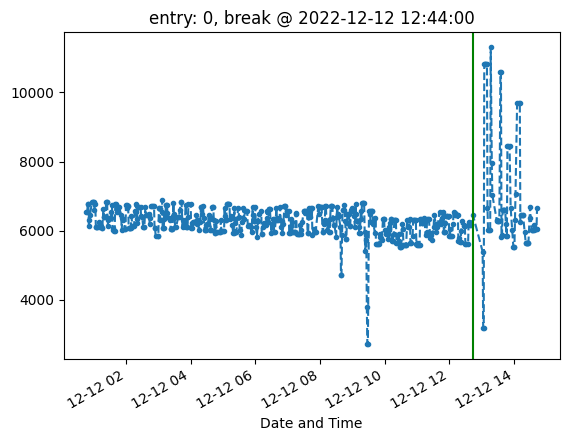

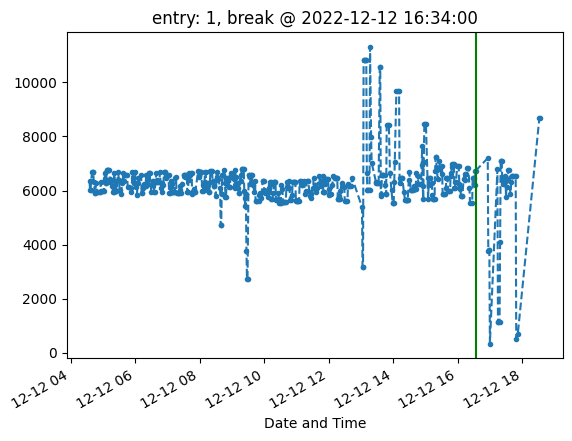

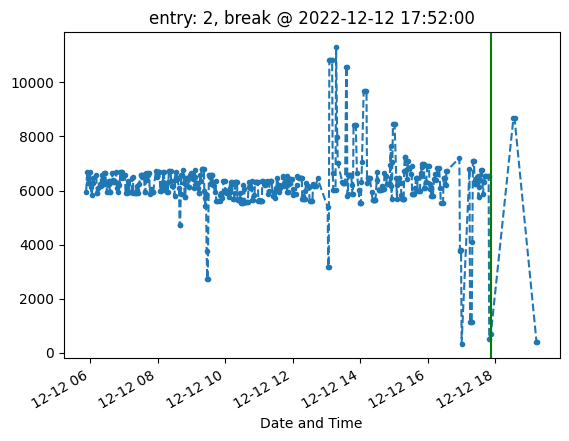

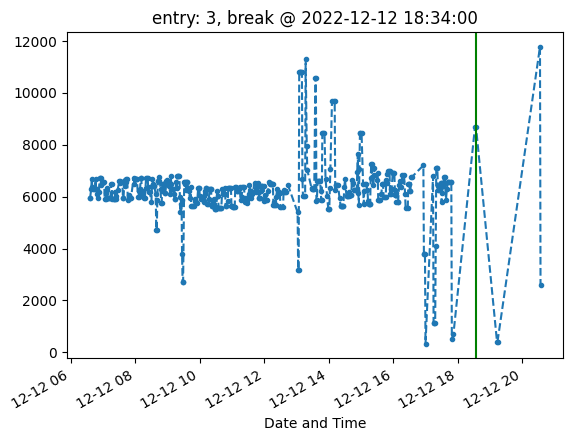

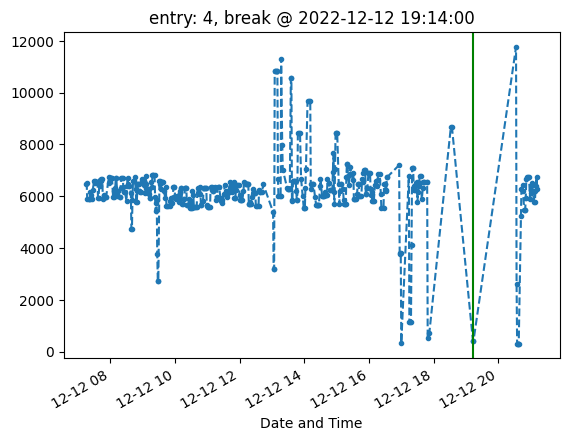

...

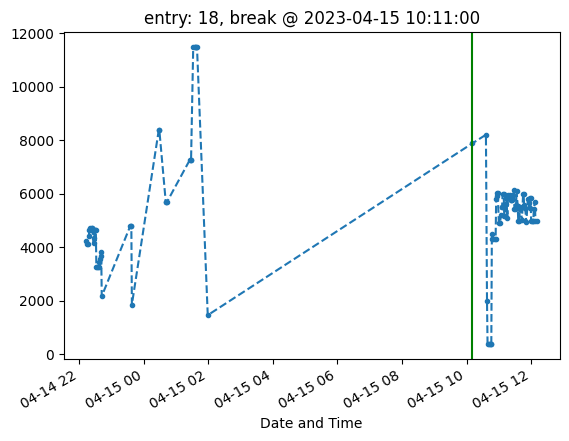

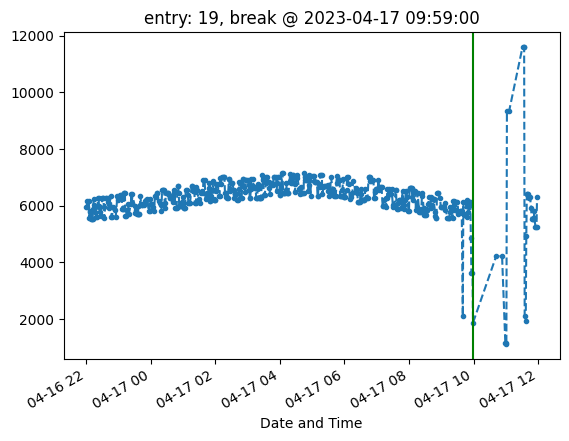

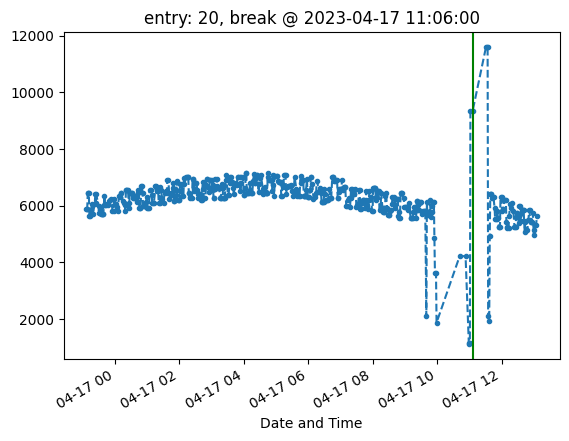

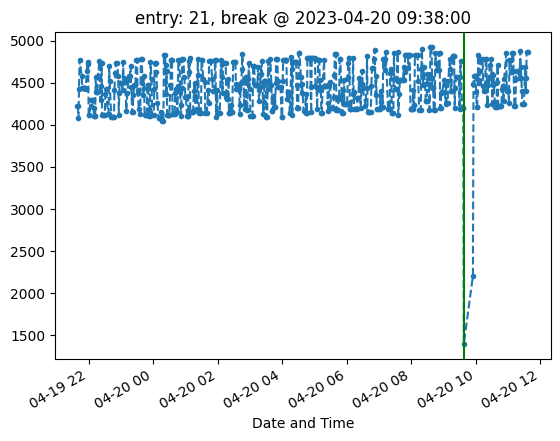

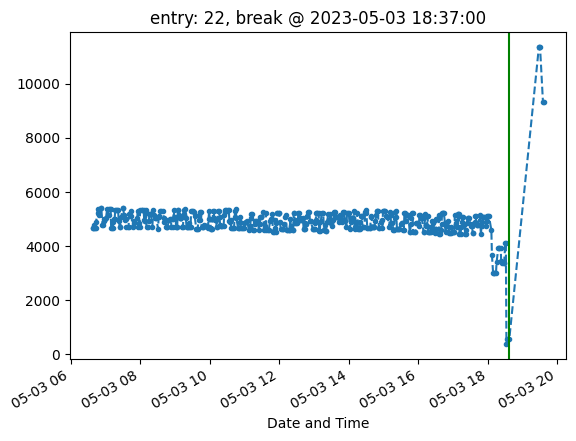

In [145]:
extruder_data = ex1_data
for (i, pause_time) in enumerate(ex1_pauses):
    early_cutoff = pause_time - pd.Timedelta(hours=12)
    late_cutoff = pause_time + pd.Timedelta(hours=2)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time}')
    plt.show()

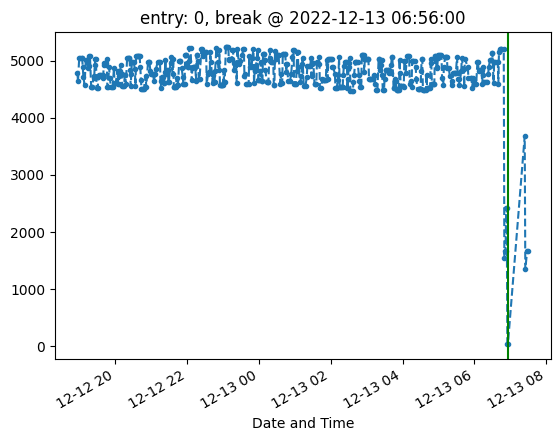

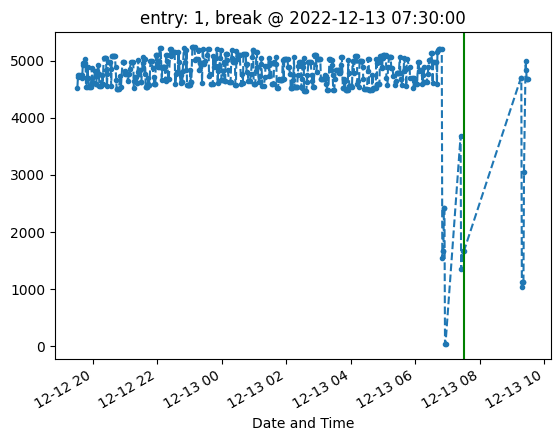

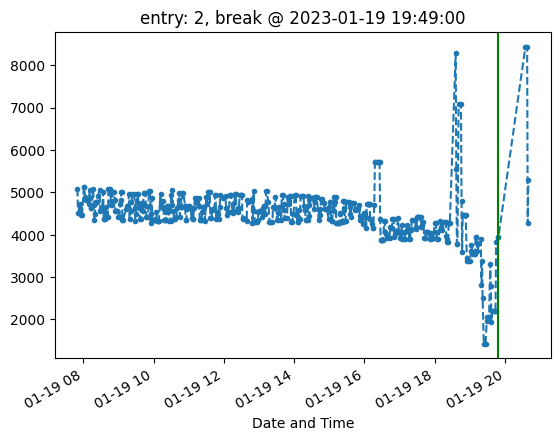

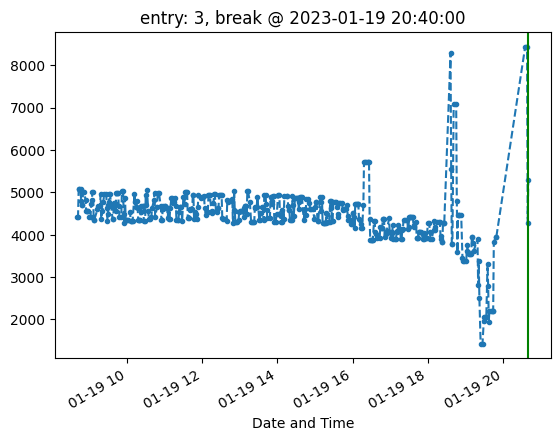

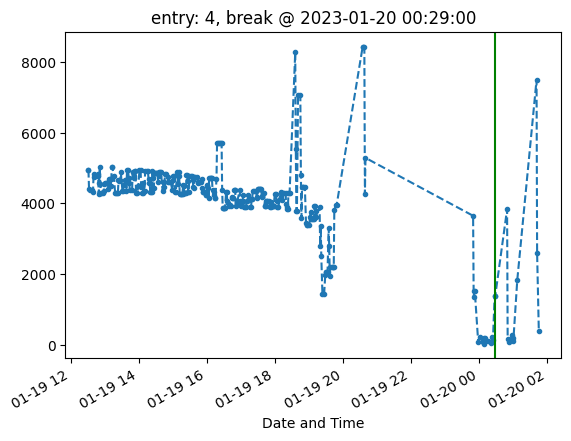

...

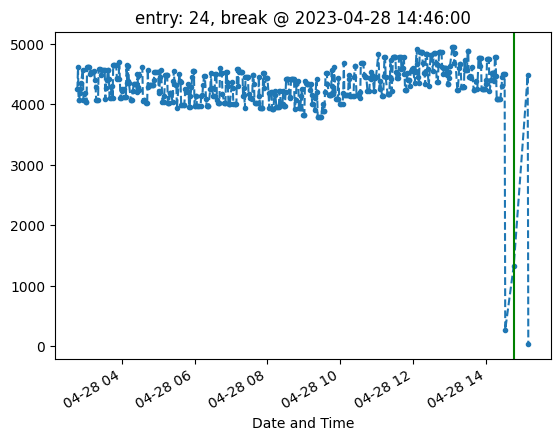

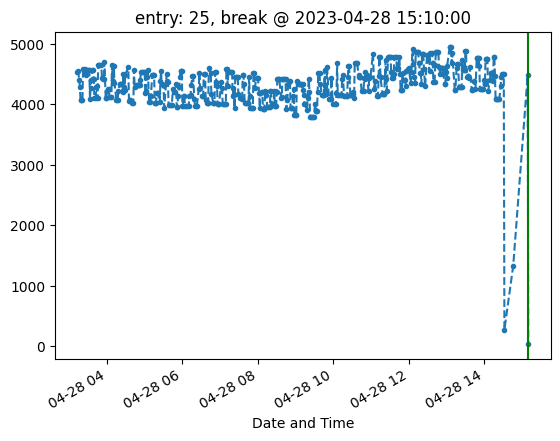

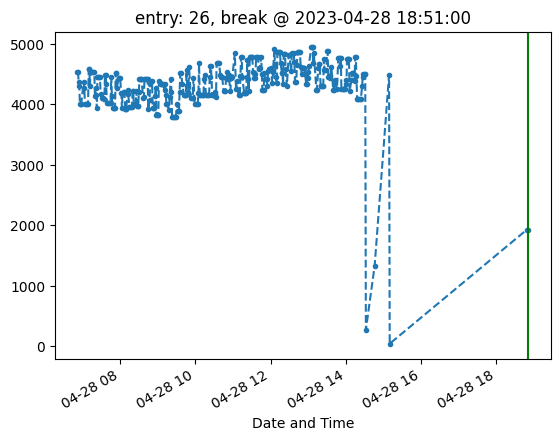

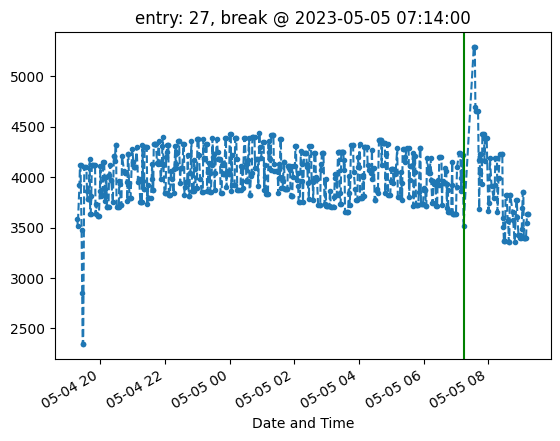

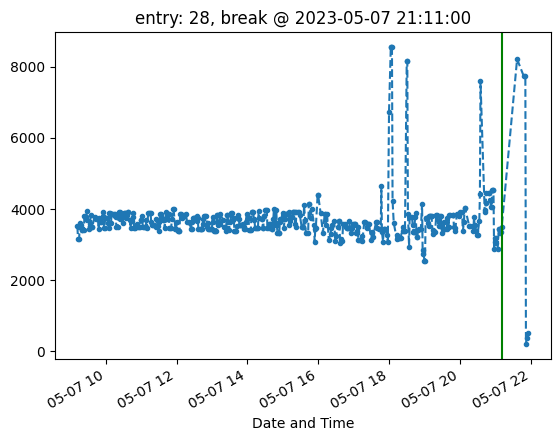

In [146]:
extruder_data = ex2_data
for (i, pause_time) in enumerate(ex2_pauses):
    
    early_cutoff = pause_time - pd.Timedelta(hours=12)
    late_cutoff = pause_time + pd.Timedelta(hours=2)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time}')
    plt.show()

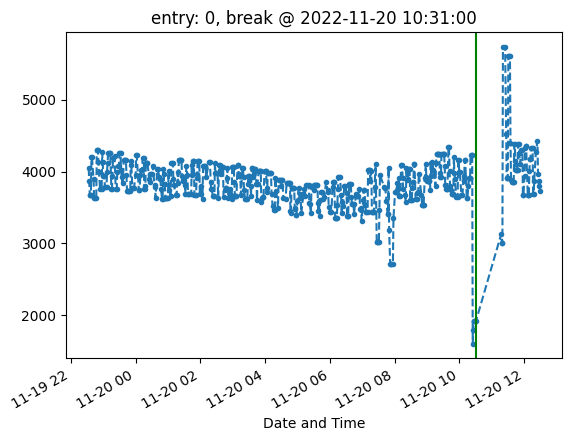

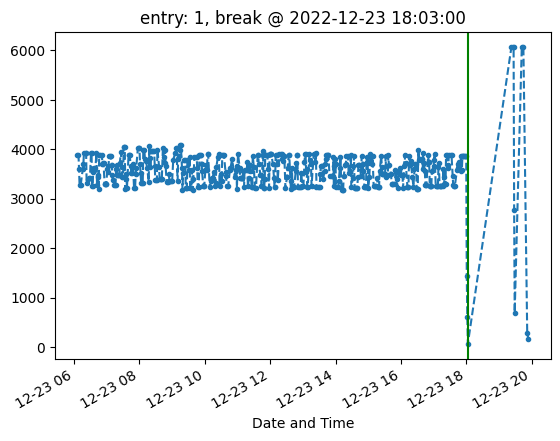

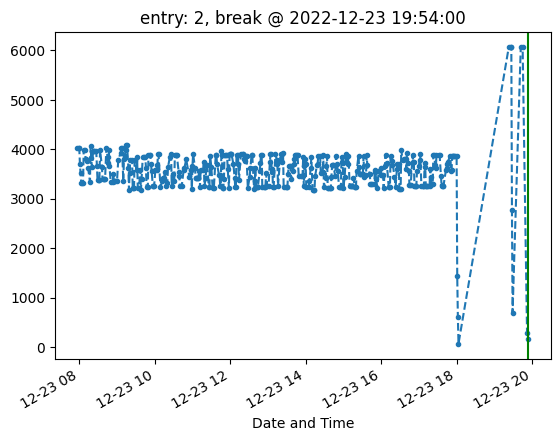

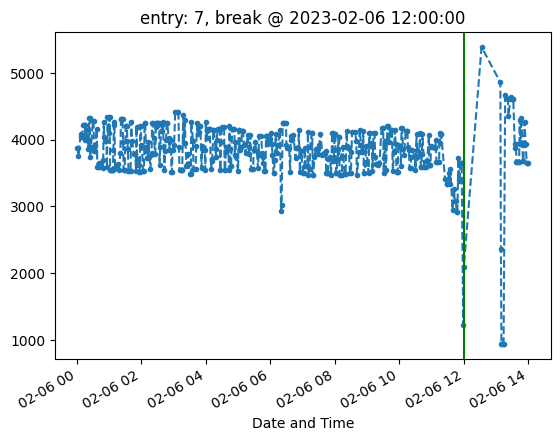

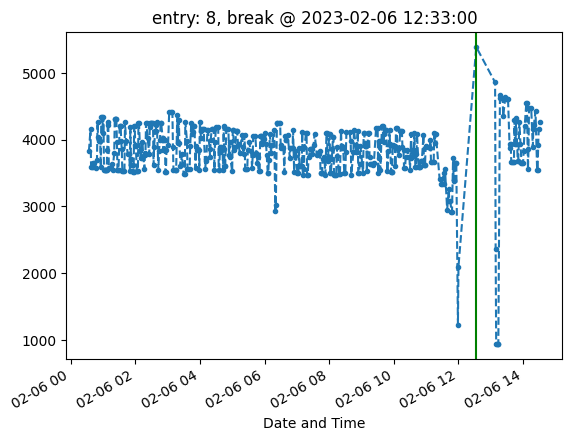

...

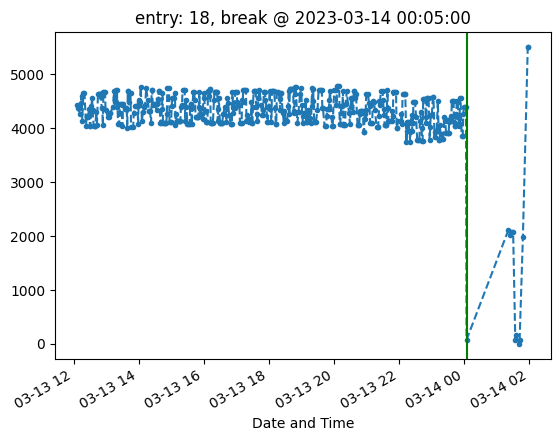

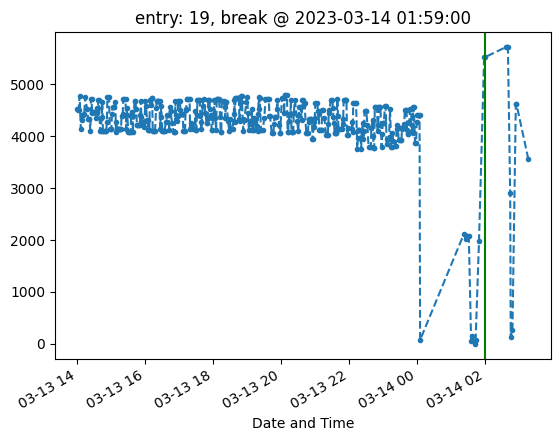

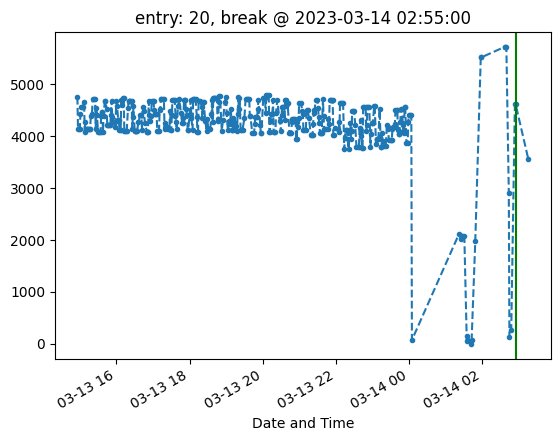

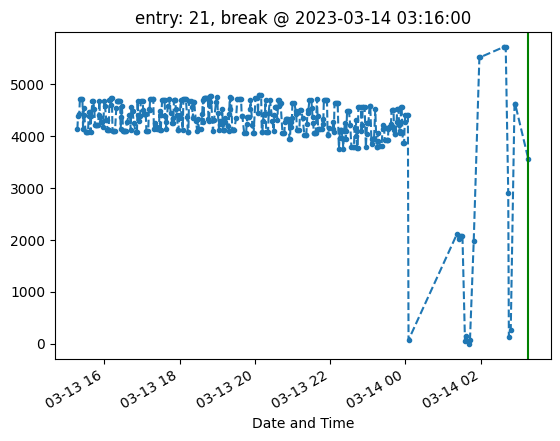

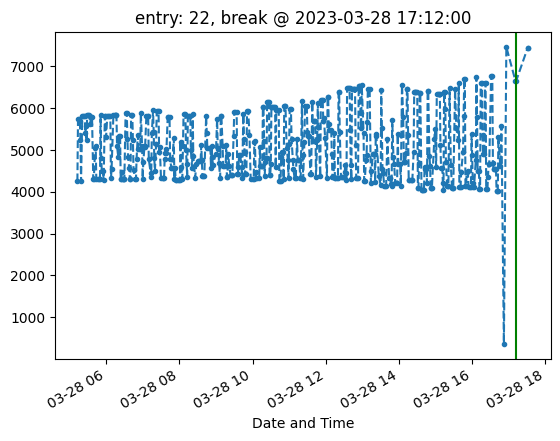

In [147]:
extruder_data = ex3_data
for (i, pause_time) in enumerate(ex3_pauses):
    
    early_cutoff = pause_time - pd.Timedelta(hours=12)
    late_cutoff = pause_time + pd.Timedelta(hours=2)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time}')
    plt.show()

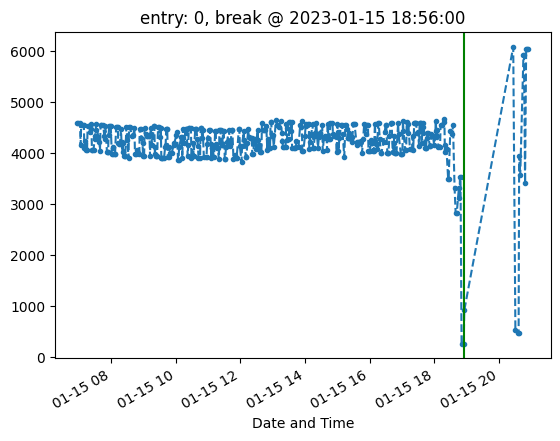

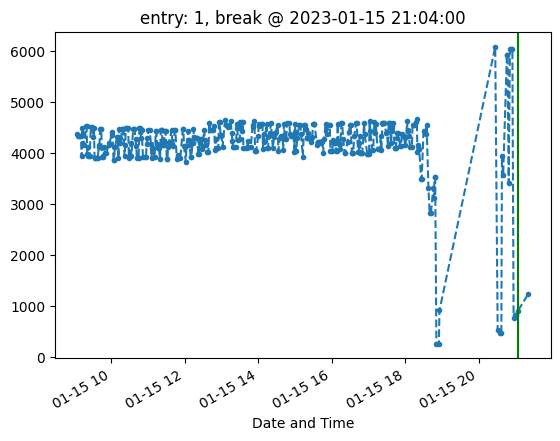

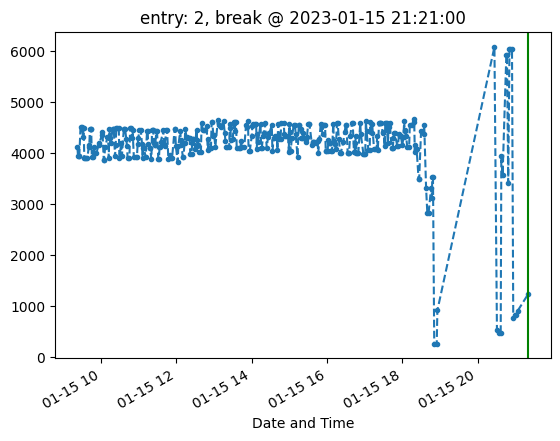

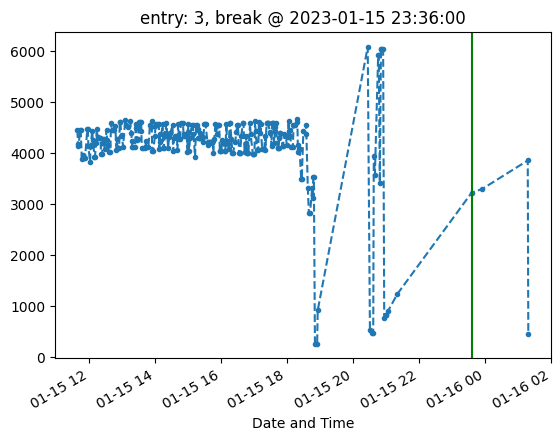

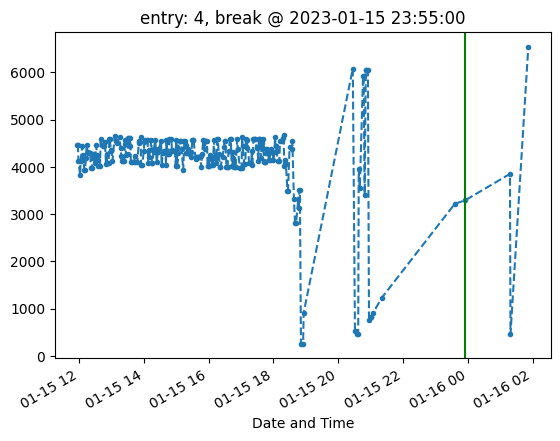

...

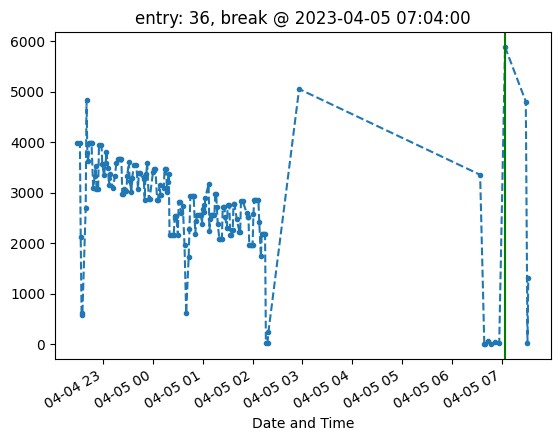

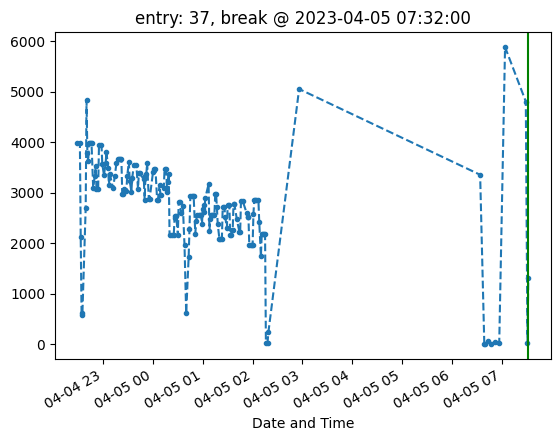

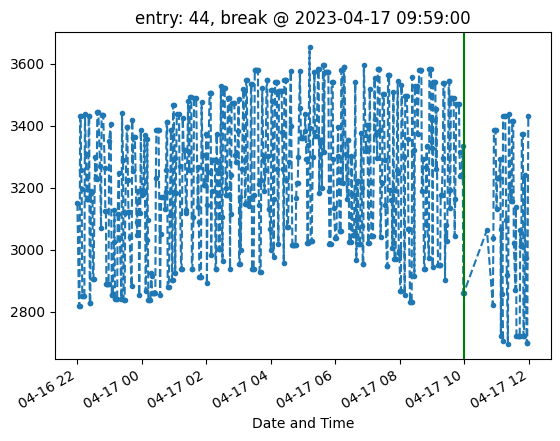

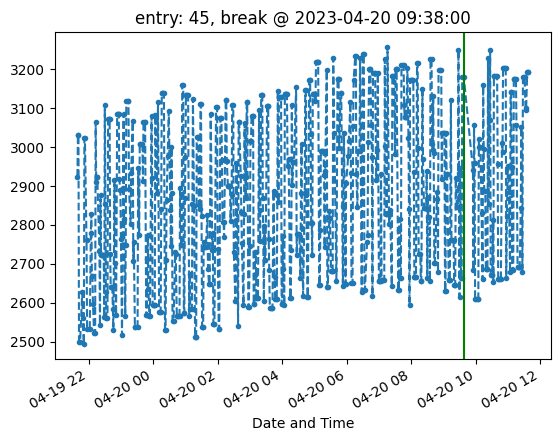

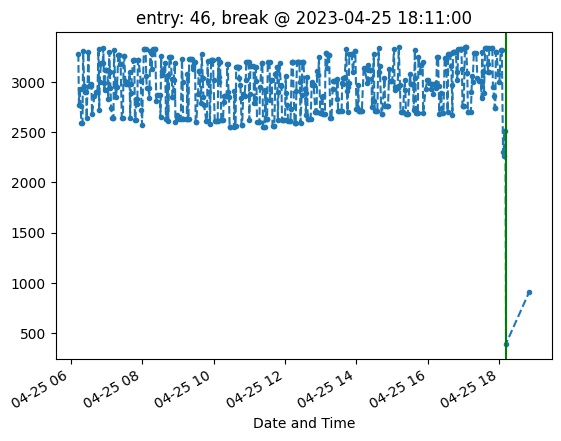

In [148]:
extruder_data = ex4_data
for (i, pause_time) in enumerate(ex4_pauses):
    
    early_cutoff = pause_time - pd.Timedelta(hours=12)
    late_cutoff = pause_time + pd.Timedelta(hours=2)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time}')
    plt.show()

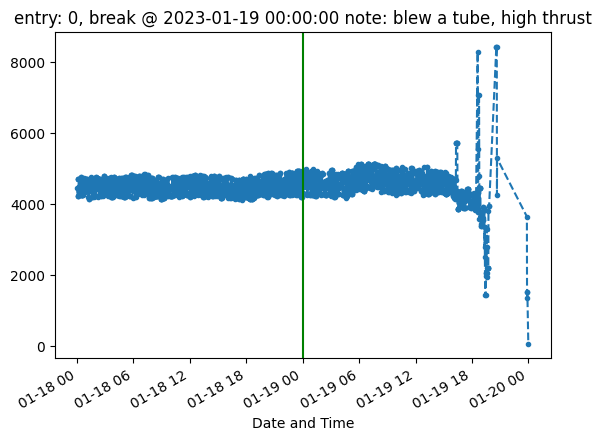

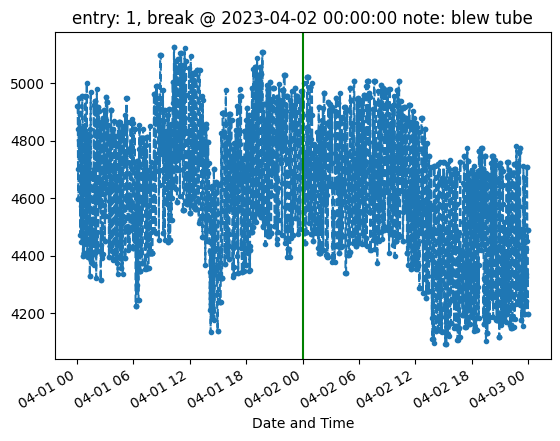

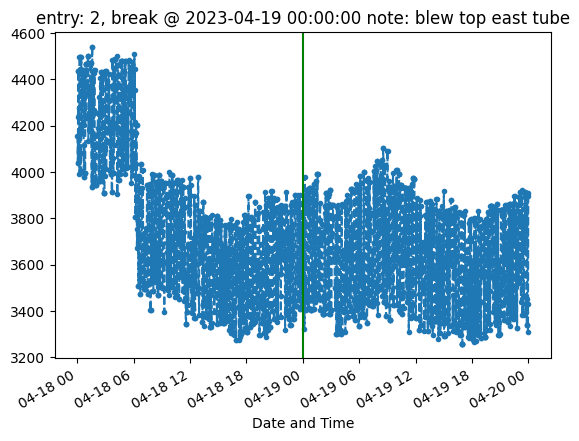

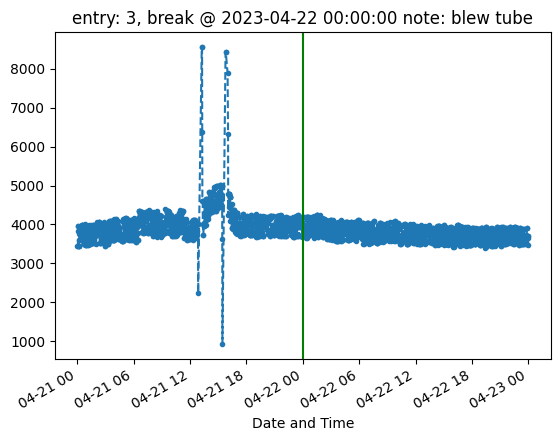

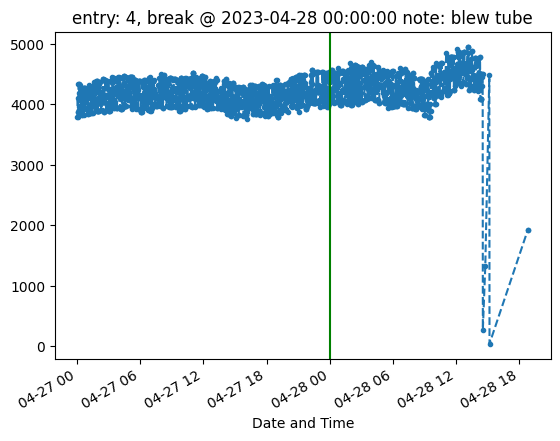

In [150]:
extruder_data = ex2_data
for (i, (pause_time, reason)) in enumerate(dates_of_interest['Ex2']):
    
    early_cutoff = pause_time - pd.Timedelta(hours=24)
    late_cutoff = pause_time + pd.Timedelta(hours=24)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time} note: {reason}')
    plt.show()

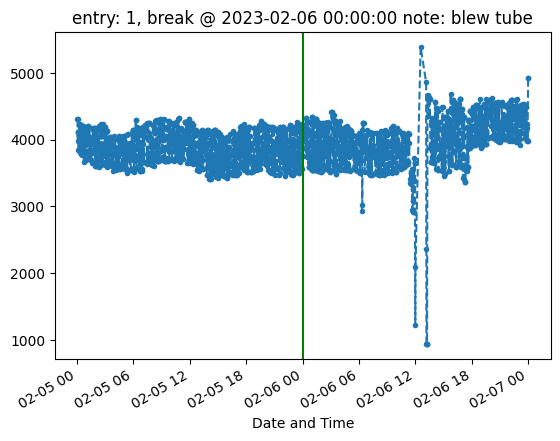

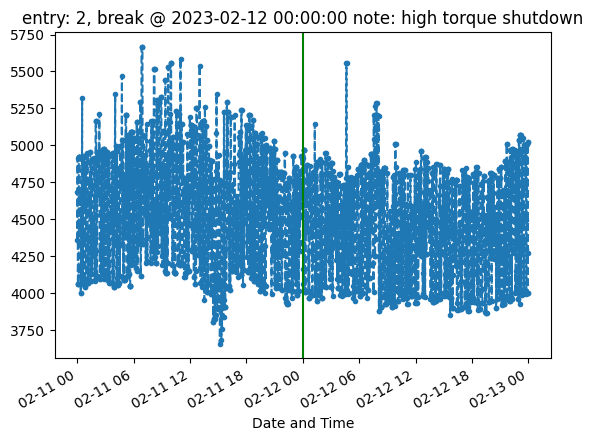

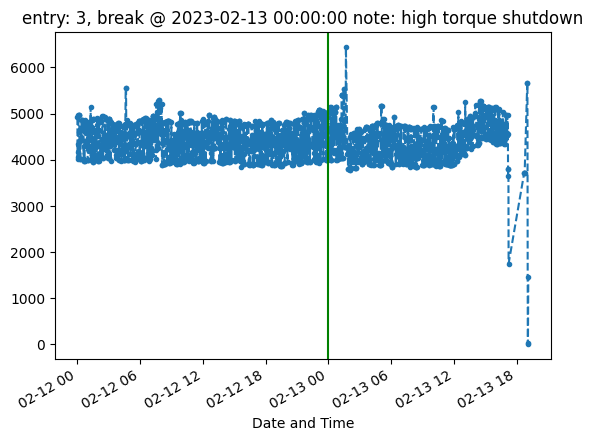

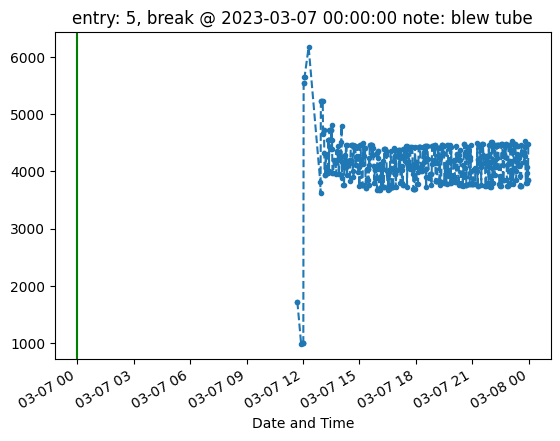

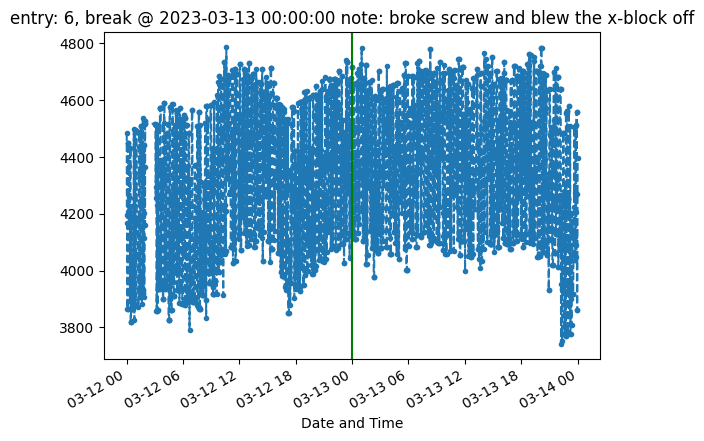

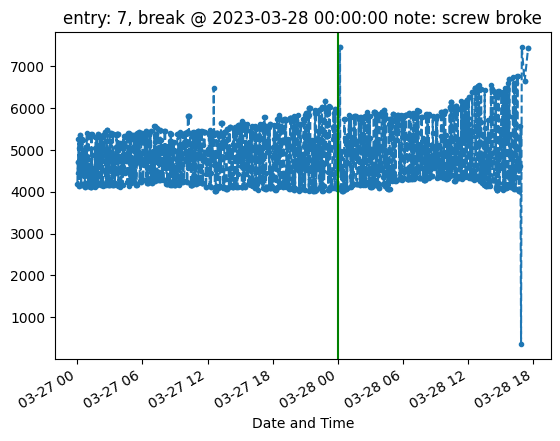

In [151]:
extruder_data = ex3_data
for (i, (pause_time, reason)) in enumerate(dates_of_interest['Ex3']):
    
    early_cutoff = pause_time - pd.Timedelta(hours=24)
    late_cutoff = pause_time + pd.Timedelta(hours=24)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time} note: {reason}')
    plt.show()

In [74]:
machine_pauses

Date and Time
2023-01-15 18:56:00   2023-01-15 18:56:00
2023-01-15 21:21:00   2023-01-15 21:21:00
2023-01-15 23:55:00   2023-01-15 23:55:00
2023-01-16 01:19:00   2023-01-16 01:19:00
2023-01-16 01:52:00   2023-01-16 01:52:00
2023-01-16 03:25:00   2023-01-16 03:25:00
2023-01-16 04:31:00   2023-01-16 04:31:00
2023-01-20 13:06:00   2023-01-20 13:06:00
2023-01-21 01:10:00   2023-01-21 01:10:00
2023-01-21 03:43:00   2023-01-21 03:43:00
2023-01-22 17:45:00   2023-01-22 17:45:00
2023-01-22 19:20:00   2023-01-22 19:20:00
2023-02-14 00:33:00   2023-02-14 00:33:00
2023-02-14 01:24:00   2023-02-14 01:24:00
2023-02-14 13:46:00   2023-02-14 13:46:00
2023-02-15 20:08:00   2023-02-15 20:08:00
2023-02-15 21:09:00   2023-02-15 21:09:00
2023-02-20 15:06:00   2023-02-20 15:06:00
2023-02-23 14:06:00   2023-02-23 14:06:00
2023-03-12 01:59:00   2023-03-12 01:59:00
2023-03-20 04:47:00   2023-03-20 04:47:00
2023-03-20 06:56:00   2023-03-20 06:56:00
2023-03-20 12:20:00   2023-03-20 12:20:00
2023-03-29 21:26:00 

In [58]:
days = extruder_data.index.normalize().unique().tolist()

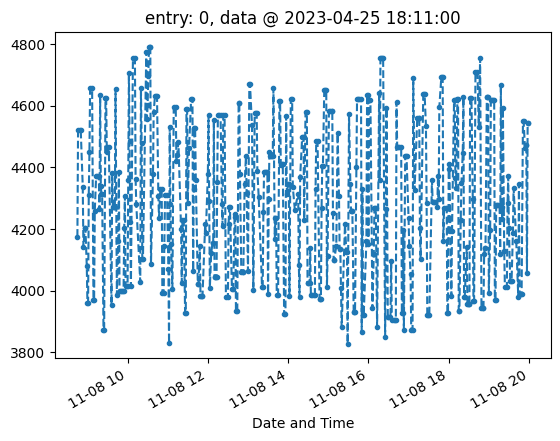

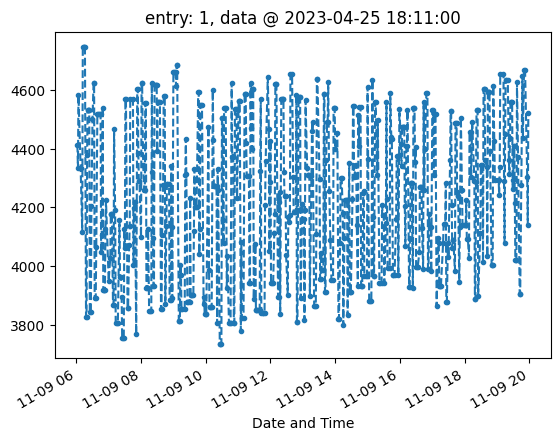

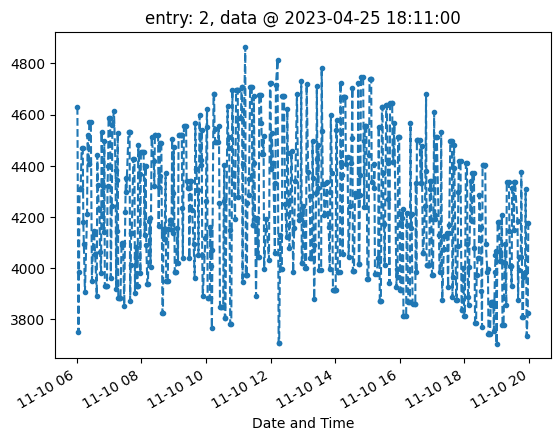

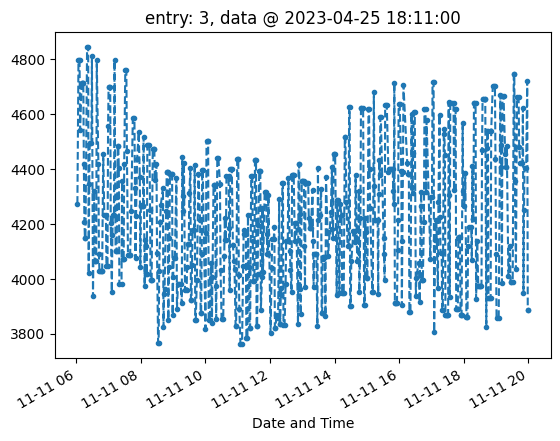

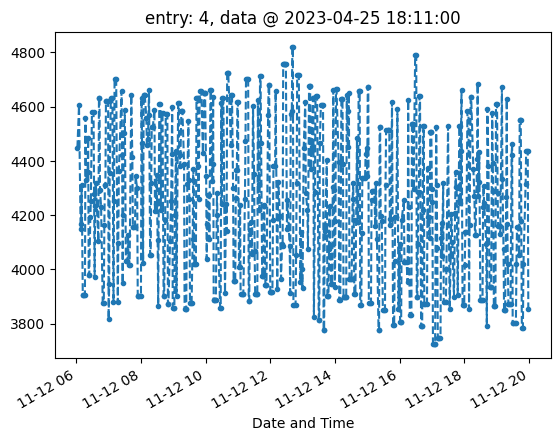

...

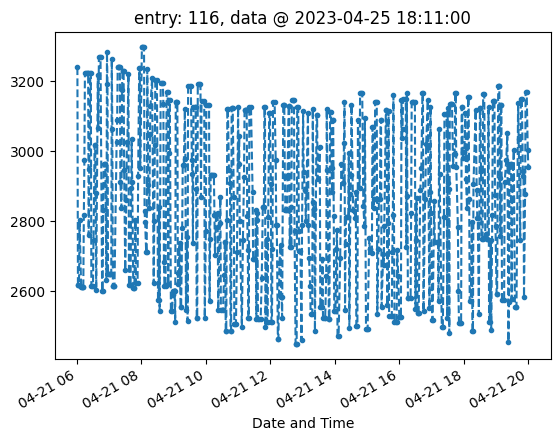

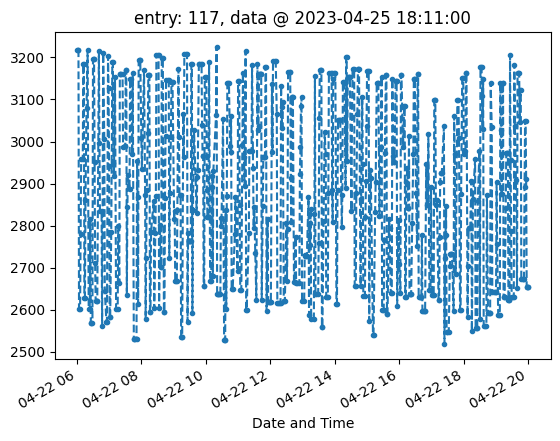

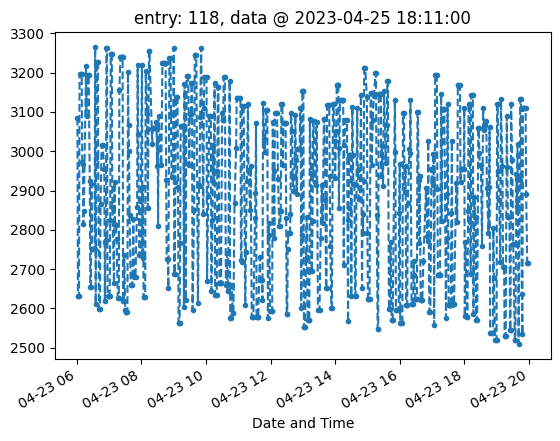

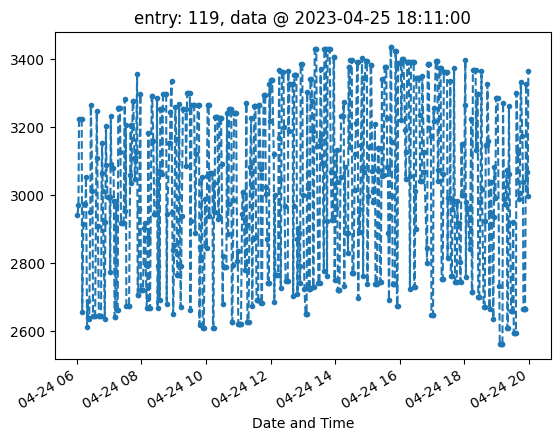

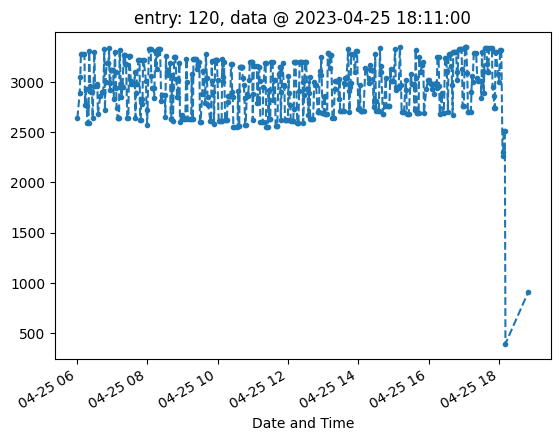

In [89]:
for (i, day) in enumerate(days):
    
    early_cutoff = day + pd.Timedelta(hours=6)
    late_cutoff = day + pd.Timedelta(hours=20)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #pauses = 
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    #plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, data @ {pause_time}')
    plt.show()
    #break

In [ ]:
len(machine_pauses)

In [62]:
extruder_data.tail(5)

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),minutes_pause
233317,2023-05-08 04:45:00,-60.14,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,34.0
233318,2023-05-08 04:46:00,-59.73,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,1.0
233319,2023-05-08 09:37:00,-59.61,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,291.0
233320,2023-05-08 09:42:00,-59.61,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,5.0
233321,2023-05-08 09:45:00,-59.61,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,3.0


In [58]:
extruder_data['Date and Time'].min(), extruder_data['Date and Time'].max()

(Timestamp('2022-11-08 08:45:00'), Timestamp('2023-05-08 09:45:00'))

In [20]:
extruder_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 233321 entries, 1 to 233321
Data columns (total 9 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Date and Time                      233321 non-null  object 
 1   Extruder Pressure                  233321 non-null  float64
 2   Screw Speed Output                 233321 non-null  float64
 3   Screw Speed                        233321 non-null  float64
 4   Extruder Die Temp                  233321 non-null  float64
 5   Extruder Thrust                    233321 non-null  float64
 6   Feed Screw Current (Amps)          233321 non-null  float64
 7   Discharge Conveyor Current (Amps)  233321 non-null  float64
 8   Discharge Conveyor Speed (%)       233321 non-null  float64
dtypes: float64(8), object(1)
memory usage: 16.0+ MB


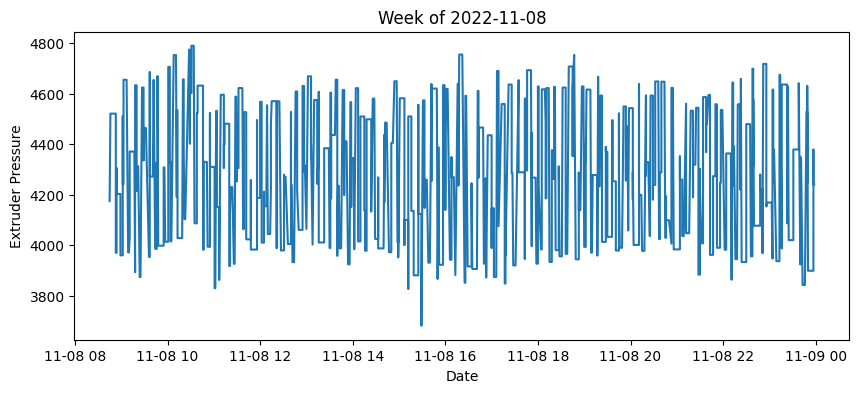

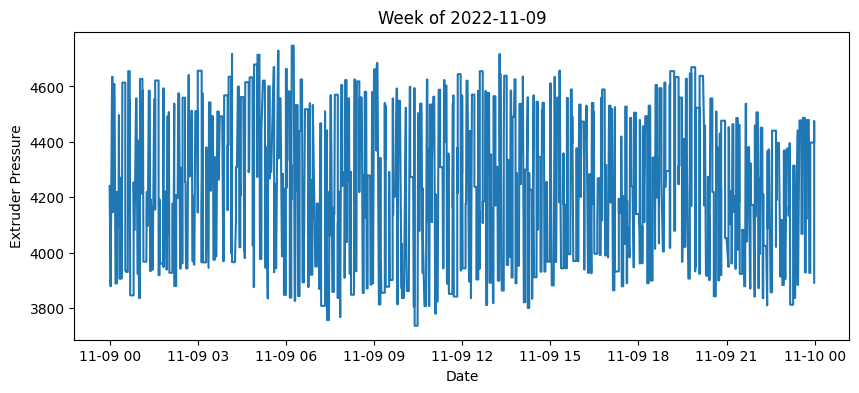

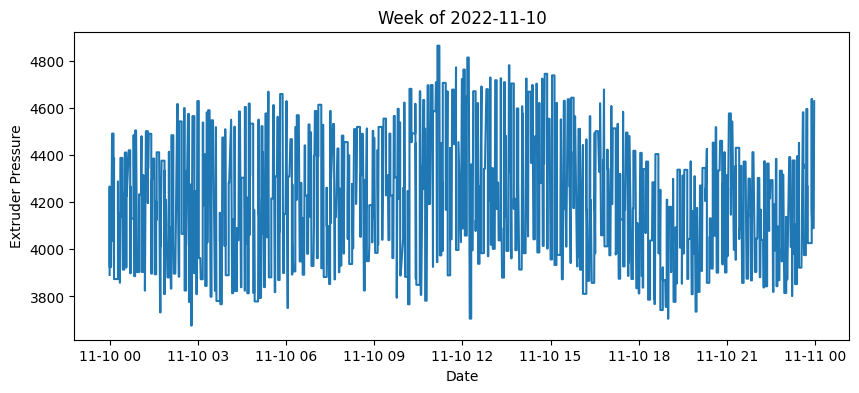

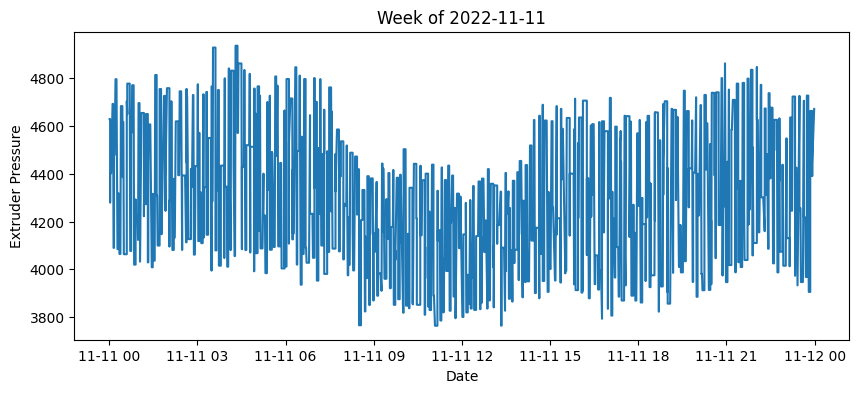

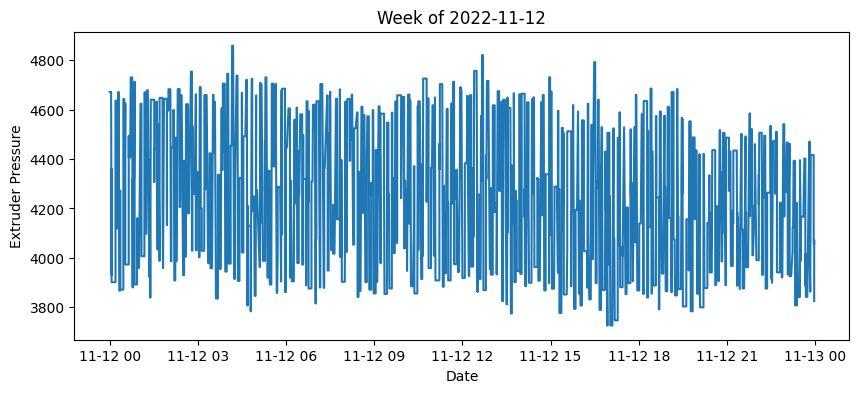

...

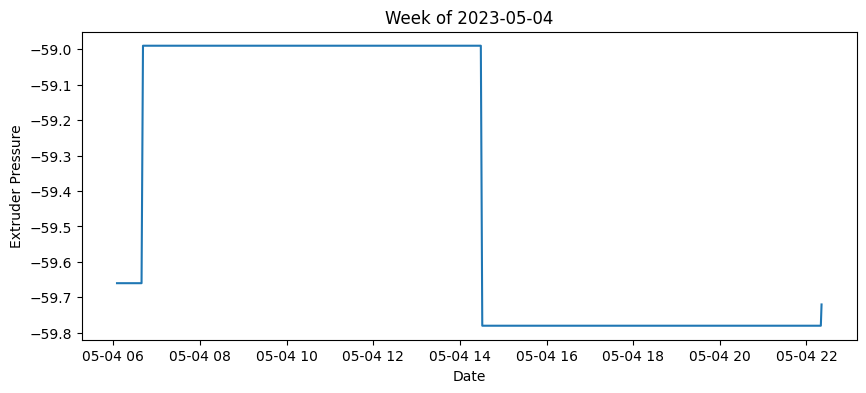

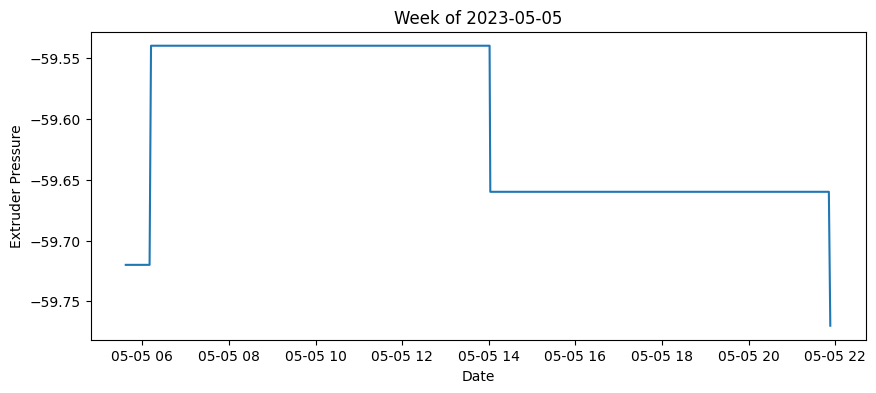

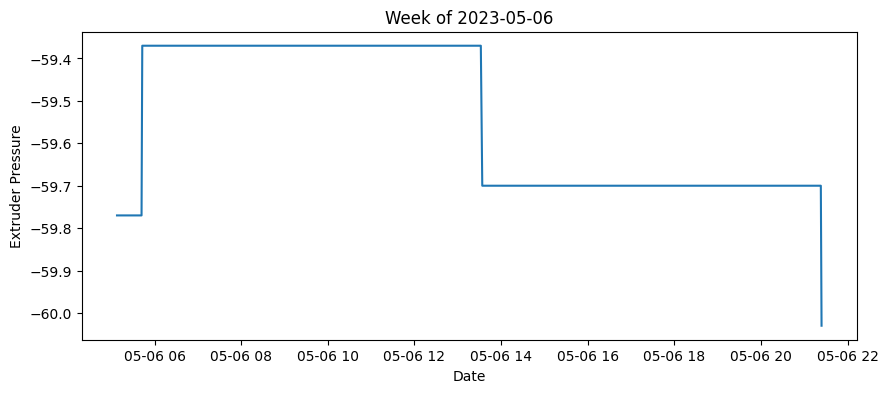

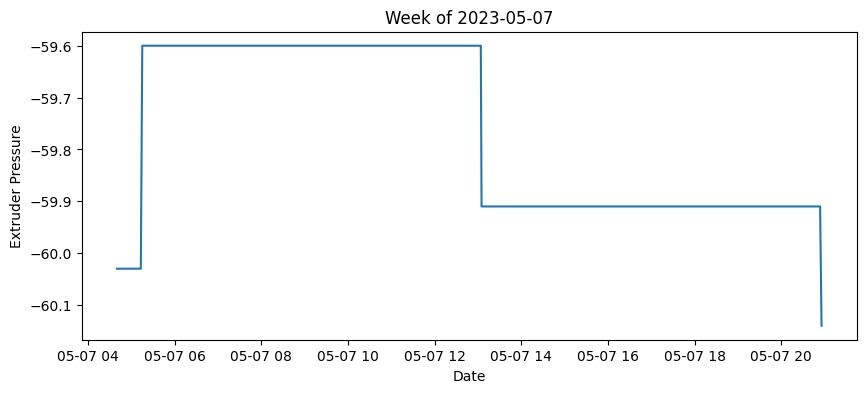

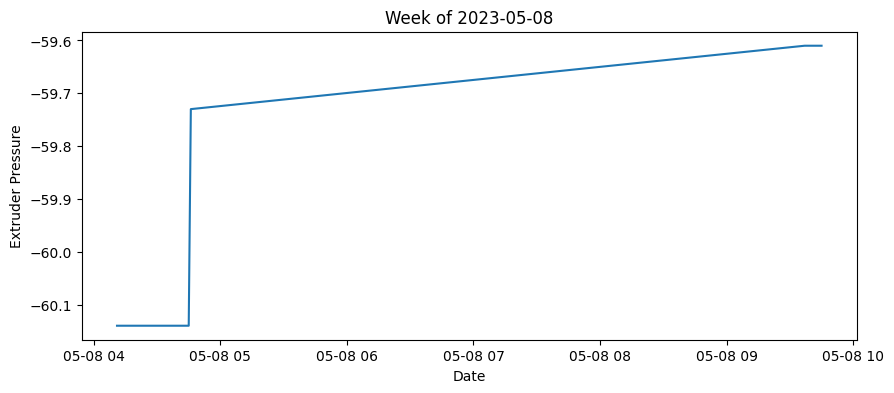

In [11]:
plot_weekly_data(extruder_data, 'Date and Time', 'Extruder Pressure')

In [46]:
extruder_data['Extruder Pressure'].mean()

3912.093890991381

In [58]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import pandas as pd
import numpy as np

inp_data = cleaned_data.drop('Date and Time', axis=1)
target = 'Extruder Pressure'

# Define the features and target variable
X = inp_data.drop(target, axis=1)  # Features (all columns except 'Target')
y = inp_data[target]               # Target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    test_size=0.2, 
    random_state=42
)

# Initialize XGBoost regressor
xg_reg = xgb.XGBRegressor(
    objective='reg:squarederror', 
    n_estimators=10, 
    seed=123
)

# Fit the model to the training set
xg_reg.fit(X_train, y_train)

# Predict the target on the test set
y_pred = xg_reg.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 37515062.26904031


In [24]:
extruder_data['time_diff'] = extruder_data['Date and Time'].diff()

In [27]:
extruder_data.head()

# pressure elevated and then dropped

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),time_diff
1,2022-11-08 08:45:00,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,NaT
2,2022-11-08 08:46:00,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,0 days 00:01:00
3,2022-11-08 08:46:00,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36,0 days 00:00:00
4,2022-11-08 08:49:00,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36,0 days 00:03:00
5,2022-11-08 08:50:00,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36,0 days 00:01:00


In [35]:
#extruder_data['time_diff'].hist()
extruder_data['time_diff_minutes'] = extruder_data['time_diff'].dt.total_seconds()/60
extruder_data['time_diff_minutes'].max()

8966.0

<Axes: ylabel='Frequency'>

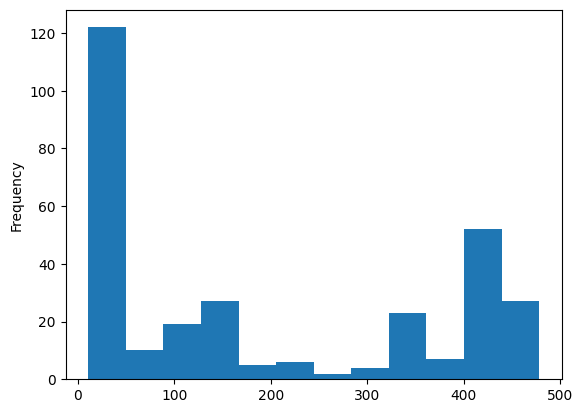

In [43]:
mask = (extruder_data['time_diff_minutes'] > 10) & (extruder_data['time_diff_minutes'] < 500)
extruder_data[mask]['time_diff_minutes'].plot(kind='hist', bins=12)

In [53]:
!pip install xgboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.1/297.1 MB 6.9 MB/s eta 0:00:00m eta 0:00:010:00:01


In [34]:
pd.set_option('display.max_columns', None)

In [39]:
test = new_df[new_df[extruder].notnull()]

In [41]:
test.head(50)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Lbs per 30 seconds * 120 / 2000,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,datetime
1,NaN,NaN,NaN,NaN,Comments,NaN,Extruder 1,NaN,NaN,NaN,NaN,Extruder 2,NaN,NaN,NaN,NaN,Extruder 3,NaN,NaN,NaN,NaN,Extruder 4\n*TEST*,NaN,NaN,NaN,NaN,NaN,PRODUCTION ENTRY,NaN,NaN,NaN,NaN,NaN,NaN,NaT
2,Date,Shift,Incoming Lead Sign Off:,Outgoing Lead Sign off:,Notes,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,NaN,Tons,Pounds,NaN,NaN,NaN,Sid,1st,NaT
3,2022-11-08 00:00:00,1st,Cody,NaN,moved 115.78 of cubes to hoop barn,NaN,DDG,12,NaN,2.5,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.1,NaN,DDG,12,NaN,2.46,114.24000,NaN,114.24,228480,NaN,NaN,NaN,NaN,NaN,2022-11-08
4,2022-11-08 00:00:00,2nd,Sid,NaN,ran good,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.42,NaN,DDG,12,NaN,2.13,NaN,DDG,12,NaN,2.44,113.40000,NaN,113.4,226800,NaN,NaN,NaN,NaN,NaN,2022-11-08
5,2022-11-09 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,43.167,2.59002,NaN,DDG,12,46,2.76,NaN,DDG,12,38,2.28,NaN,DDG,12,45.167,2.71002,124.08048,NaN,124.08048,248160.96,NaN,NaN,NaN,NaN,NaN,2022-11-09
6,2022-11-09 00:00:00,2nd,Taylor,NaN,ran good,NaN,DDG,12,42.3,2.538,NaN,DDG,12,47.3,2.838,NaN,DDG,12,39,2.34,NaN,DDG,12,45.8,2.748,125.56800,NaN,125.568,251136,NaN,NaN,NaN,NaN,NaN,2022-11-09
7,2022-11-10 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,42.5,2.55,NaN,DDG,12,45.7,2.742,NaN,DDG,12,38,2.28,NaN,DDG,12,45,2.7,123.26400,NaN,123.264,246528,NaN,NaN,NaN,NaN,NaN,2022-11-10
8,2022-11-10 00:00:00,2nd,taylor,NaN,ran good,NaN,DDG,12,44.3,2.658,NaN,DDG,12,49.3,2.958,NaN,DDG,12,40.8,2.448,NaN,DDG,12,46,2.76,129.88800,NaN,129.888,259776,NaN,NaN,NaN,NaN,NaN,2022-11-10
9,2022-11-11 00:00:00,1st,Cody,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43.3,2.598,NaN,DDG,12,39.4,2.364,NaN,DDG,12,43,2.58,120.74400,NaN,120.744,241488,NaN,NaN,NaN,NaN,NaN,2022-11-11
10,2022-11-11 00:00:00,2nd,Sid,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43,2.58,NaN,DDG,12,38,2.28,NaN,DDG,12,42.5,2.55,119.16000,NaN,119.16,238320,NaN,NaN,NaN,NaN,NaN,2022-11-11


In [38]:
new_df.head(50)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Lbs per 30 seconds * 120 / 2000,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,datetime
1,NaN,NaN,NaN,NaN,Comments,NaN,Extruder 1,NaN,NaN,NaN,NaN,Extruder 2,NaN,NaN,NaN,NaN,Extruder 3,NaN,NaN,NaN,NaN,Extruder 4\n*TEST*,NaN,NaN,NaN,NaN,NaN,PRODUCTION ENTRY,NaN,NaN,NaN,NaN,NaN,NaN,NaT
2,Date,Shift,Incoming Lead Sign Off:,Outgoing Lead Sign off:,Notes,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,NaN,Tons,Pounds,NaN,NaN,NaN,Sid,1st,NaT
3,2022-11-08 00:00:00,1st,Cody,NaN,moved 115.78 of cubes to hoop barn,NaN,DDG,12,NaN,2.5,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.1,NaN,DDG,12,NaN,2.46,114.24000,NaN,114.24,228480,NaN,NaN,NaN,NaN,NaN,2022-11-08
4,2022-11-08 00:00:00,2nd,Sid,NaN,ran good,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.42,NaN,DDG,12,NaN,2.13,NaN,DDG,12,NaN,2.44,113.40000,NaN,113.4,226800,NaN,NaN,NaN,NaN,NaN,2022-11-08
5,2022-11-09 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,43.167,2.59002,NaN,DDG,12,46,2.76,NaN,DDG,12,38,2.28,NaN,DDG,12,45.167,2.71002,124.08048,NaN,124.08048,248160.96,NaN,NaN,NaN,NaN,NaN,2022-11-09
6,2022-11-09 00:00:00,2nd,Taylor,NaN,ran good,NaN,DDG,12,42.3,2.538,NaN,DDG,12,47.3,2.838,NaN,DDG,12,39,2.34,NaN,DDG,12,45.8,2.748,125.56800,NaN,125.568,251136,NaN,NaN,NaN,NaN,NaN,2022-11-09
7,2022-11-10 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,42.5,2.55,NaN,DDG,12,45.7,2.742,NaN,DDG,12,38,2.28,NaN,DDG,12,45,2.7,123.26400,NaN,123.264,246528,NaN,NaN,NaN,NaN,NaN,2022-11-10
8,2022-11-10 00:00:00,2nd,taylor,NaN,ran good,NaN,DDG,12,44.3,2.658,NaN,DDG,12,49.3,2.958,NaN,DDG,12,40.8,2.448,NaN,DDG,12,46,2.76,129.88800,NaN,129.888,259776,NaN,NaN,NaN,NaN,NaN,2022-11-10
9,2022-11-11 00:00:00,1st,Cody,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43.3,2.598,NaN,DDG,12,39.4,2.364,NaN,DDG,12,43,2.58,120.74400,NaN,120.744,241488,NaN,NaN,NaN,NaN,NaN,2022-11-11
10,2022-11-11 00:00:00,2nd,Sid,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43,2.58,NaN,DDG,12,38,2.28,NaN,DDG,12,42.5,2.55,119.16000,NaN,119.16,238320,NaN,NaN,NaN,NaN,NaN,2022-11-11


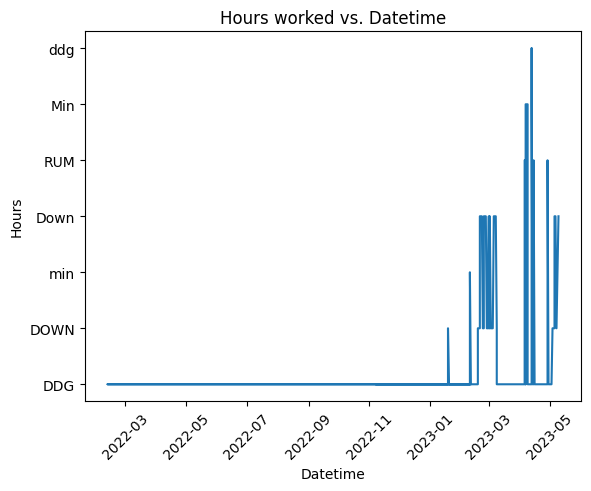

In [36]:
import pandas as pd
import matplotlib.pyplot as plt

# Plot the graph
plt.plot(new_df['datetime'], new_df[extruder])
plt.xlabel('Datetime')
plt.ylabel('Hours')
plt.title('Hours worked vs. Datetime')
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.show()

In [7]:
extruder_data.head().T

,1,2,3,4,5
Date and Time,11/8/2022 8:45 AM,11/8/2022 8:46 AM,11/8/2022 8:46 AM,11/8/2022 8:49 AM,11/8/2022 8:50 AM
Extruder Pressure,4174.38,4521.09,4521.09,4521.09,4521.09
Screw Speed Output,63.1,63.1,63.1,63.1,63.1
Screw Speed,-0.94,-0.94,-0.94,-0.94,-0.94
Extruder Die Temp,11.28,11.28,11.28,11.28,11.28
Extruder Thrust,34.12,34.12,34.62,34.62,34.62
Feed Screw Current (Amps),5.21,5.21,5.21,5.21,5.21
Discharge Conveyor Current (Amps),0.95,0.95,0.95,1.01,0.9
Discharge Conveyor Speed (%),75.36,75.36,75.36,75.36,75.36


In [22]:
extruder_data.head(50)

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%)
1,11/8/2022 8:45 AM,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36
2,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36
3,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36
4,11/8/2022 8:49 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36
5,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36
6,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,33.45,5.21,0.90,75.36
7,11/8/2022 8:53 AM,4521.09,63.1,-0.94,11.28,33.45,5.22,0.90,75.36
8,11/8/2022 8:53 AM,4521.09,63.1,-0.94,11.28,33.45,0.00,0.90,75.36
9,11/8/2022 8:53 AM,3969.78,63.1,-0.94,11.28,33.45,0.00,0.90,75.36
10,11/8/2022 8:54 AM,3969.78,63.1,-0.94,11.28,34.11,0.00,0.90,75.36


<Axes: >

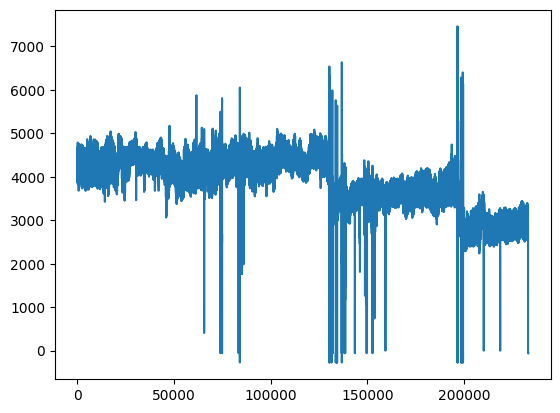

In [25]:
#extruder_data[extruder_data['Extruder Pressure'] < 1]['Extruder Pressure'].plot()
#extruder_data['Extruder Pressure'].plot()
extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure'].plot()
plt.plot()

In [59]:
extruder_data['outlier'] = (extruder_data['Extruder Pressure'] > 5100)

In [60]:
extruder_data.head()

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),outlier
1,11/8/2022 8:45 AM,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
2,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
3,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36,False
4,11/8/2022 8:49 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36,False
5,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36,False


In [ ]:
extruder_data[extruder_data['Extruder Pressure'] < 1]['Extruder Pressure'].plot()

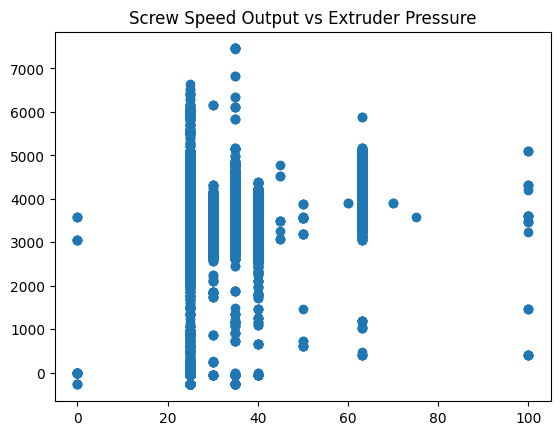

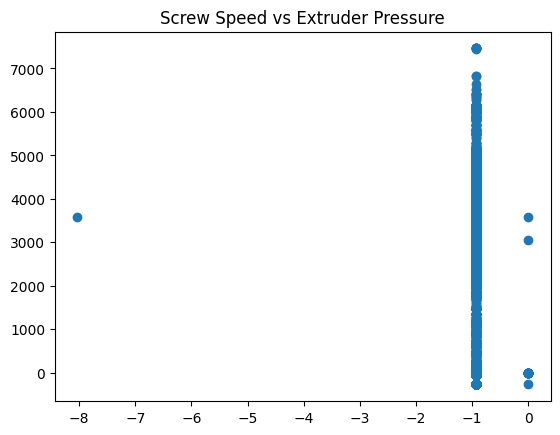

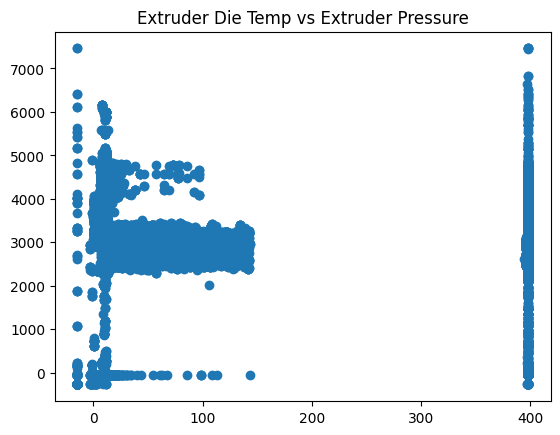

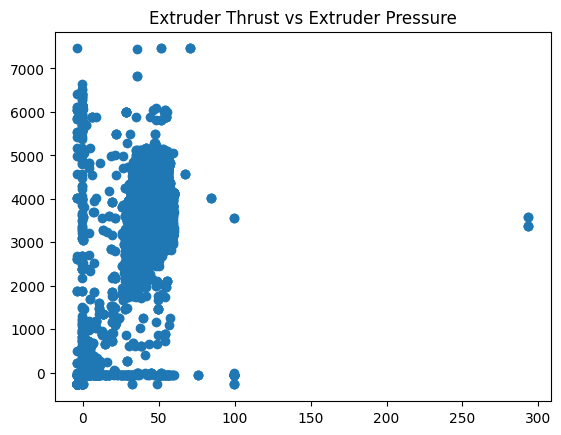

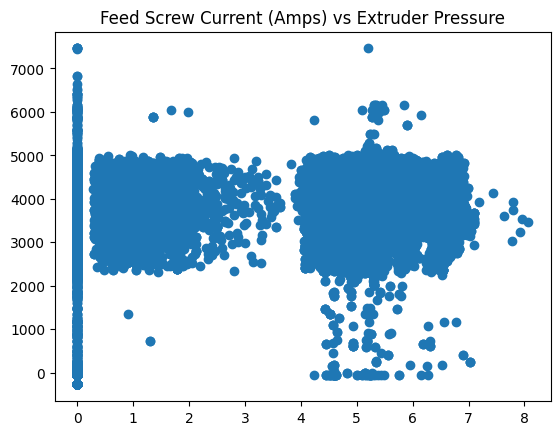

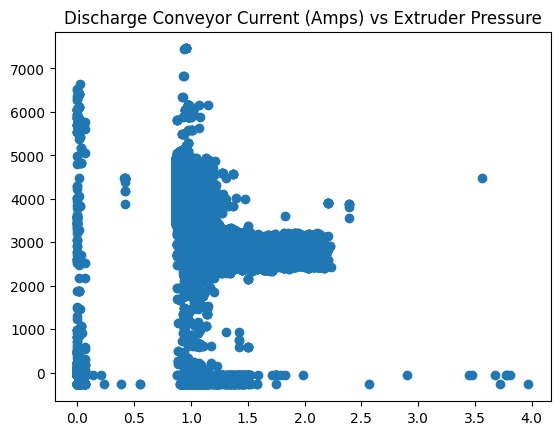

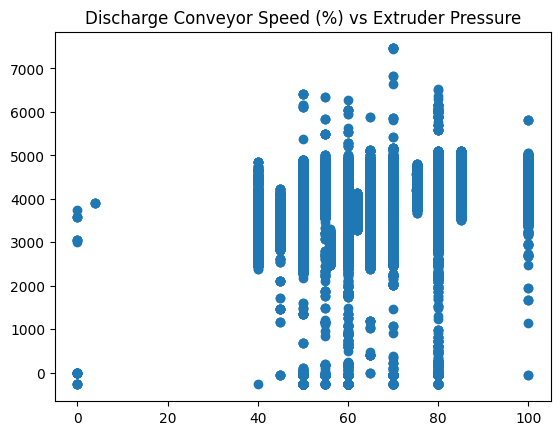

In [26]:
import matplotlib.pyplot as plt

output_channel = 'Extruder Pressure'

input_channels = ['Screw Speed Output', 
                  'Screw Speed', 
                  'Extruder Die Temp',
                 'Extruder Thrust',
                 'Feed Screw Current (Amps)',
                 'Discharge Conveyor Current (Amps)',
                 'Discharge Conveyor Speed (%)']

for inpt in input_channels:
    
    dependent = extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure']
    independent = extruder_data[extruder_data['Extruder Pressure'] < 1e5][inpt]
    
    plt.scatter(independent, dependent)
    plt.title(f'{inpt} vs Extruder Pressure')
    plt.show()

<Axes: >

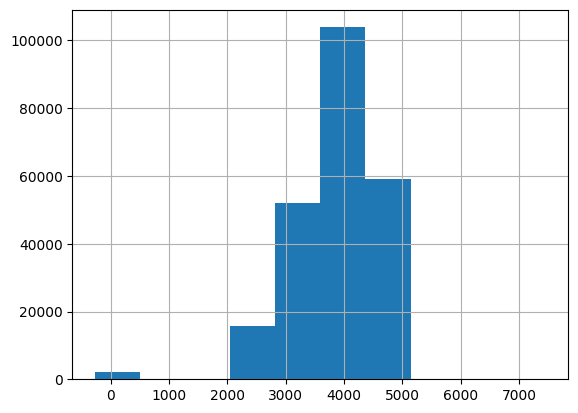

In [42]:
extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure'].hist()

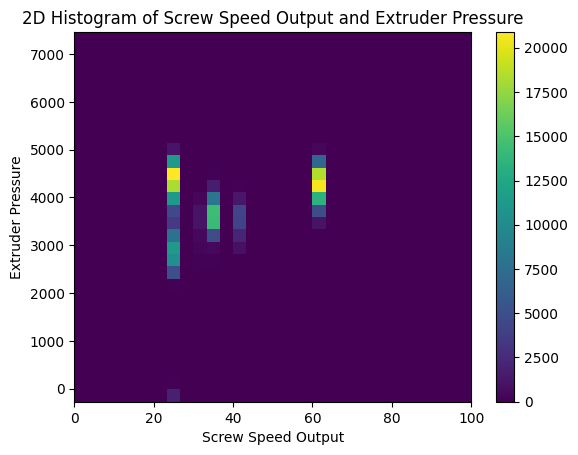

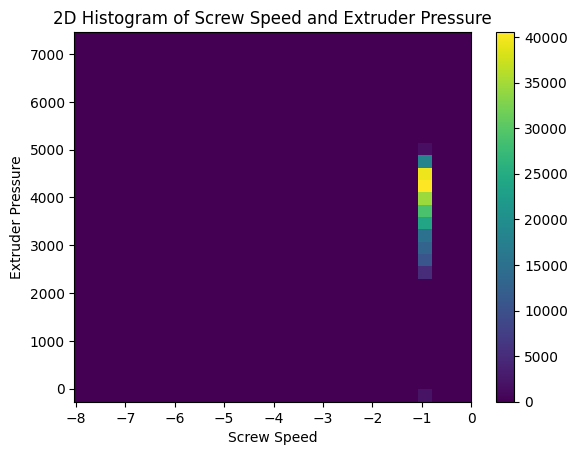

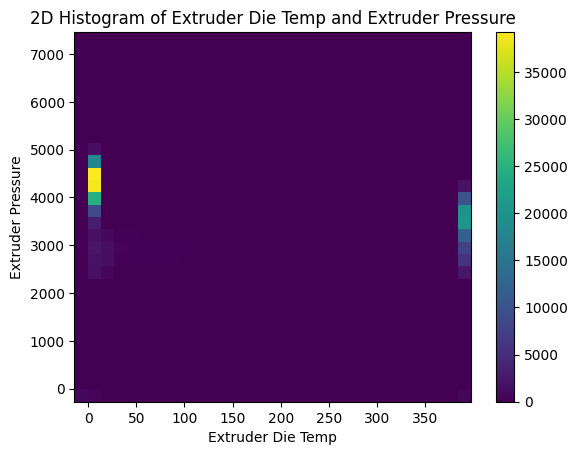

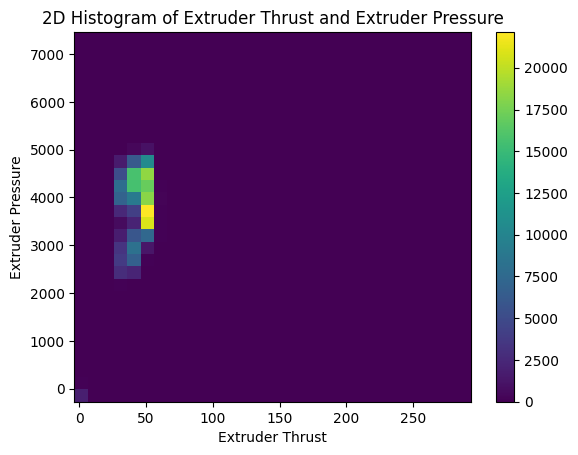

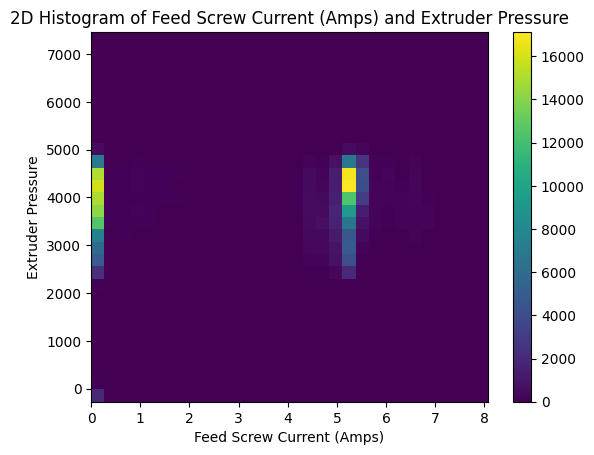

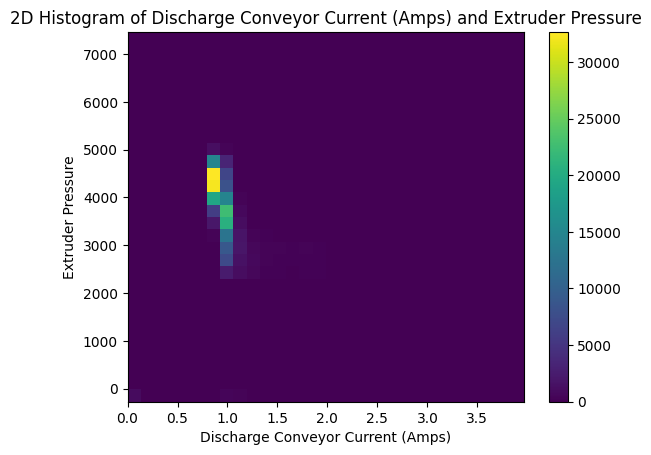

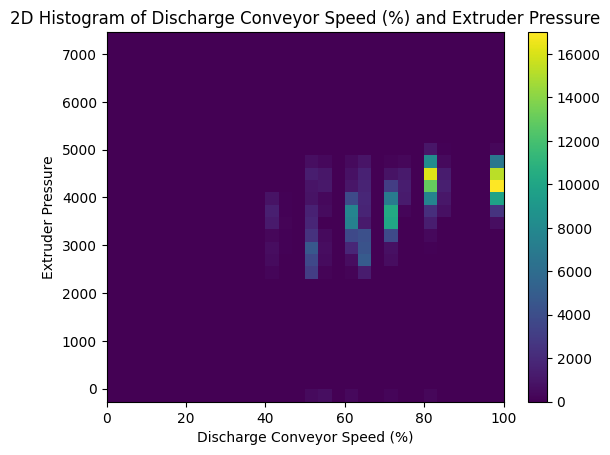

In [44]:
# Example DataFrame with two normally distributed columns

for inpt in input_channels:
    
    dependent = extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure']
    independent = extruder_data[extruder_data['Extruder Pressure'] < 1e5][inpt]

    # Plotting the 2D histogram for the DataFrame columns
    plt.hist2d(independent, dependent, bins=30)
    plt.colorbar()  # To show the color scale
    plt.title(f'2D Histogram of {inpt} and Extruder Pressure')
    plt.xlabel(inpt)
    plt.ylabel('Extruder Pressure')
    plt.show()

In [45]:
import pandas as pd
import matplotlib.pyplot as plt

def calculate_correlations(data, target_column, 
                           ascending=False, 
                           include_categorical=True
):
    # Calculate correlations for numerical columns with the target variable
    if include_categorical:
        data_encoded = handle_categorical_columns(data)
        included_features = data_encoded.columns.tolist()
    else:
        data_encoded = data
        included_features = data.select_dtypes(exclude=['object']).columns.tolist()
        
    numerical_correlations = data_encoded[included_features].corr()[target_column].abs()
    
    return numerical_correlations.sort_values(ascending=ascending)

def handle_categorical_columns(data):
    # Separate categorical and numerical columns
    categorical_cols = data.select_dtypes(include=['object']).columns.tolist()
    
    if not categorical_cols:
        return data
    
    # Handle categorical columns (one-hot encoding)
    data_encoded = pd.get_dummies(data, columns=categorical_cols, drop_first=True)
    return data_encoded

def plot_correlation_bar(correlations, 
                         top_n=10, 
                         show_values=False
):
    # Create a bar plot
    fig, ax = plt.subplots(figsize=(10, 6))
    bars = correlations[:top_n].plot(kind='bar', color='skyblue', ax=ax)
    plt.title(f'Top {top_n} Correlated Features')
    plt.xlabel('Feature')
    plt.ylabel('Correlation')
    plt.xticks(rotation=90)
    plt.tight_layout()
    
    # Optionally add correlation values above each bar
    if show_values:
        for bar in bars.patches:
            ax.annotate(
                f'{bar.get_height():.2f}', (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                ha='center', va='bottom'
            )
    
    plt.show()

def select_top_correlated_features(data, target_column, 
                                   top_n=10, 
                                   show_values=False,
                                   ascending=False):

    correlations = calculate_correlations(data, target_column)
    # Plot the top correlated features with optional values
    plot_correlation_bar(correlations, top_n, show_values)
    
    # Return both the correlations and the top N correlated feature names
    top_feature_names = correlations.index.tolist()[:top_n]
    return correlations, top_feature_names

# Example usage:
# Assuming you have a DataFrame 'df' with mixed data types and the target variable is '


In [71]:
cleaned_data = extruder_data[extruder_data['Extruder Pressure'].notnull()]

cleaned_data = cleaned_data[cleaned_data['Extruder Pressure'] < 1e5]
cleaned_data = cleaned_data[cleaned_data['Extruder Thrust'] < 70]
cleaned_data = cleaned_data[cleaned_data['Extruder Thrust'] > 25]

In [75]:
extruder_data['Date and Time'].min(), extruder_data['Date and Time'].max()

('1/1/2023 10:00 AM', '5/8/2023 9:45 AM')

In [50]:
cleaned_data.shape

(233321, 9)

In [62]:
cleaned_data.head()

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),outlier
1,11/8/2022 8:45 AM,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
2,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
3,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36,False
4,11/8/2022 8:49 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36,False
5,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36,False


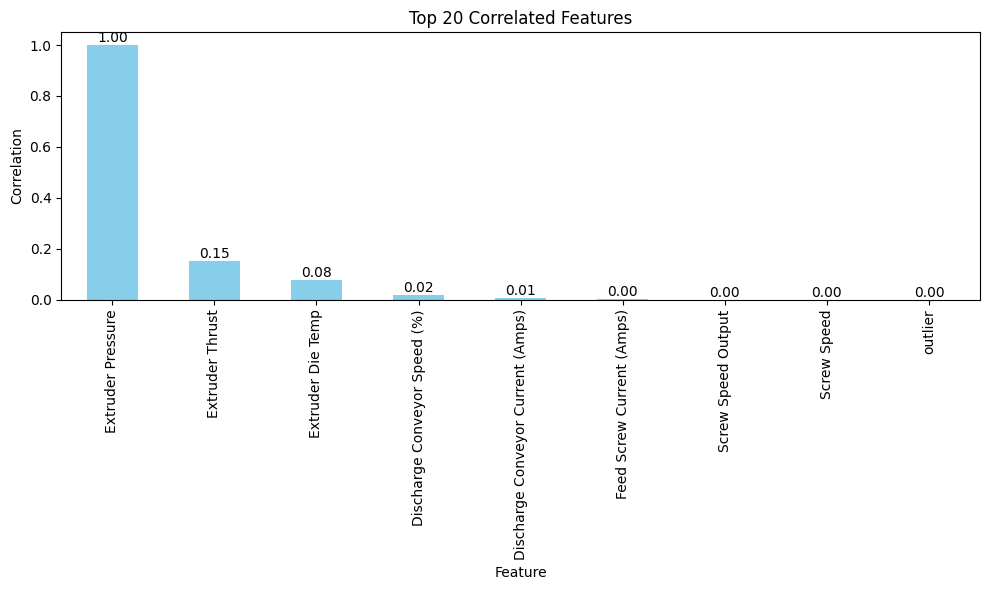

In [66]:
correlations, selected_features = select_top_correlated_features(
    cleaned_data[:10000].drop('Date and Time', axis=1), 'Extruder Pressure', top_n=20, show_values=True)

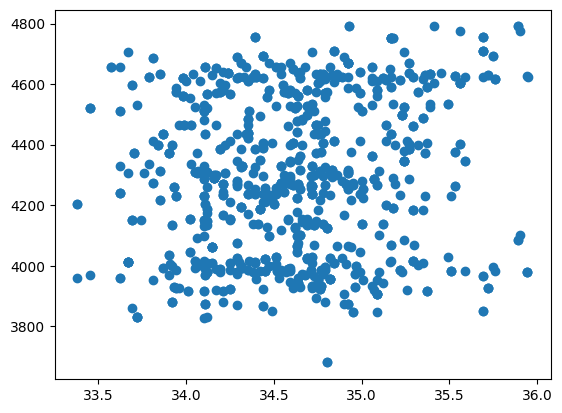

In [74]:
plt.scatter(cleaned_data[:1000]['Extruder Thrust'], cleaned_data[:1000]['Extruder Pressure'])

<Axes: >

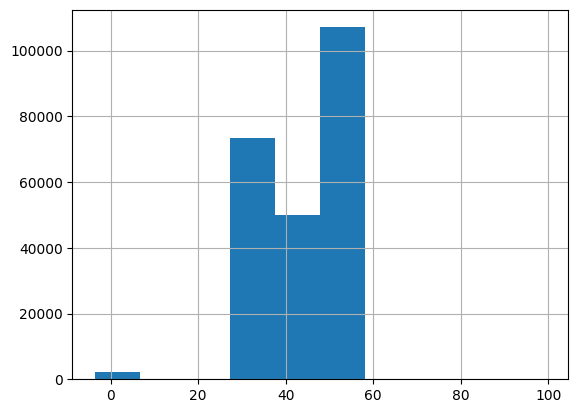

In [68]:
cleaned_data['Extruder Thrust'].hist()

In [ ]:
correlations, selected_features = select_top_correlated_features(
    cleaned_data[10000:20000], 'Extruder Pressure', top_n=20, show_values=True)

In [76]:
def plot_weekly_data(df, datetime_col, numeric_col):
    """
    Plots a separate line plot for each week of data in the DataFrame.

    Parameters:
    df (pandas.DataFrame): The DataFrame containing the data.
    datetime_col (str): The name of the column with datetime objects.
    numeric_col (str): The name of the numeric column to plot.
    """
    # Convert the datetime column to pandas datetime type if it's not already
    df[datetime_col] = pd.to_datetime(df[datetime_col])

    # Set the datetime column as the index of the DataFrame
    df.set_index(datetime_col, inplace=True)

    # Resample the data by week and plot each week
    for week, weekly_data in df[numeric_col].resample('W'):
        plt.figure(figsize=(10, 4))
        plt.plot(weekly_data.index, weekly_data.values)
        plt.title(f"Week of {week.strftime('%Y-%m-%d')}")
        plt.xlabel('Date')
        plt.ylabel(numeric_col)
        plt.show()

In [7]:
extruder_data["Screw Speed"]

1        -0.94
2        -0.94
3        -0.94
4        -0.94
5        -0.94
          ... 
233317   -0.94
233318   -0.94
233319   -0.94
233320   -0.94
233321   -0.94
Name: Screw Speed, Length: 233321, dtype: float64

In [ ]:
def plot_weekly_data(df, datetime_col, numeric_col):
    """
    Plots a separate line plot for each week of data in the DataFrame.

    Parameters:
    df (pandas.DataFrame): The DataFrame containing the data.
    datetime_col (str): The name of the column with datetime objects.
    numeric_col (str): The name of the numeric column to plot.
    """
    # Convert the datetime column to pandas datetime type if it's not already
    df[datetime_col] = pd.to_datetime(df[datetime_col])

    # Set the datetime column as the index of the DataFrame
    df.set_index(datetime_col, inplace=True)

    # Resample the data by week and plot each week
    for week, weekly_data in df[numeric_col].resample('W'):
        plt.figure(figsize=(10, 4))
        plt.plot(weekly_data.index, weekly_data.values)
        plt.title(f"Week of {week.strftime('%Y-%m-%d')}")
        plt.xlabel('Date')
        plt.ylabel(numeric_col)
        plt.show()

In [8]:
import pandas as pd
from sklearn.neighbors import LocalOutlierFactor
import numpy as np

def detect_outliers_larger_than(df, column_name, n_neighbors=3, contamination=0.1, threshold=None):

    column_data = df[column_name]
    # Reshape the data to have a single feature
    column_data_reshaped = column_data.values.reshape(-1, 1)

    lof = LocalOutlierFactor(n_neighbors=n_neighbors, contamination=contamination)

    # Fit the model to the column data
    lof.fit(column_data_reshaped)

    # Predict the anomaly scores
    anomaly_scores = lof.negative_outlier_factor_

    # Add the anomaly scores to the DataFrame
    df['AnomalyScore'] = anomaly_scores
    
    threshold = np.abs(df['AnomalyScore']).quantile(threshold)

    # Select the top 5% values using boolean indexing
    top_5_percent = df[np.abs(df['AnomalyScore']) > threshold]

    return top_5_percent

In [9]:
import pandas as pd
from sklearn.neighbors import LocalOutlierFactor

def detect_outliers(df, column_name, n_neighbors=3, contamination=0.1, threshold_lower=None, threshold_upper=None):

    column_data = df[column_name]

    # Reshape the data to have a single feature
    column_data_reshaped = column_data.values.reshape(-1, 1)

    lof = LocalOutlierFactor(n_neighbors=n_neighbors, contamination=contamination)

    # Fit the model to the column data
    lof.fit(column_data_reshaped)

    # Predict the anomaly scores
    anomaly_scores = lof.negative_outlier_factor_

    # Add the anomaly scores to the DataFrame
    df['AnomalyScore'] = anomaly_scores

    # Identify the anomalies based on the condition
    if threshold_lower is not None and threshold_upper is not None:
        threshold_lower_value = np.abs(df['AnomalyScore']).quantile(threshold_lower)
        threshold_upper_value = np.abs(df['AnomalyScore']).quantile(threshold_upper)
        
        print(threshold_lower_value, threshold_upper_value)
        anomalies = df[(df['AnomalyScore'].abs() > threshold_lower_value) & (df['AnomalyScore'].abs() < threshold_upper_value)]
    else:
        anomalies = df

    return anomalies

In [10]:
def plot_line_graph_with_collapsed_points(new_df, points_df, original, column_name, title):
    # Convert 'date' column to datetime type in new_df
    new_df['date'] = pd.to_datetime(new_df['datetime'], errors='coerce')

    # Convert 'datetime' column to datetime type in points_df
    points_df['datetime'] = pd.to_datetime(points_df['Date and Time'], errors='coerce').dt.date

    # Group points_df by 'datetime' and aggregate 'column_name' using mean
    points_df_collapsed = points_df.groupby('datetime')[column_name].mean().reset_index()

    # Plot the line graph with dates data
    fig, ax1 = plt.subplots(figsize=(20,12))
    
    # Plot the line graph on the left y-axis
    ax1.plot(new_df['date'], new_df[extruder], label='Hours Worked')
    ax1.set_xlabel('Date')
    ax1.set_ylabel('Hours Worked')

    # Create a second y-axis for 'Extruder Pressure' values
    ax2 = ax1.twinx()

    # Plot the 'Extruder Pressure' values on the right y-axis
    ax2.scatter(points_df_collapsed['datetime'], points_df_collapsed[column_name], color='red',
                label=f'Mean Daily {column_name}')

    # Add a plate to label the mean extruder pressure
    # for i, row in points_df_collapsed.iterrows():
    #     ax2.annotate(round(row[column_name], 2), (row['datetime'], row[column_name]),
    #                  xytext=(5, 0), textcoords='offset points', ha='left', va='bottom')
    mean_value = original[column_name].mean()
    ax2.annotate(f'{column_name} Mean: {str(round(mean_value, 2))}', (new_df['datetime'].iloc[0],
                                                                  mean_value),
                 xytext=(-200, -100), textcoords='offset points', ha='left', va='bottom', color='darkorange')
    ax2.set_ylabel(column_name)

    # Rotate x-axis labels for better visibility
    plt.xticks(rotation=45)

    # Show legend
    ax1.legend(loc='upper left')
    ax2.legend(loc='lower left')

    # Title for the plot
    plt.title(f"{title}")

    plt.show()

In [11]:
column_name = "Extruder Pressure"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.995)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

133333334.33018042 333333334.334546


NameError: name 'new_df' is not defined

In [ ]:
column_name = "Screw Speed Output"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Screw Speed"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Extruder Die Temp"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Extruder Thrust"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Feed Screw Current (Amps)"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Discharge Conveyor Current (Amps)"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Discharge Conveyor Speed (%)"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")